<a href="https://colab.research.google.com/github/Oleksy1121/Car-damage-detection/blob/main/training/YOLOv8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Instalacja i wstępna konfiguracja
Skrypt instaluje i konfiguruje bibliotekę YOLO (You Only Look Once) do zadań związanych z detekcją obiektów. Dodatkowo, importowane są niezbędne biblioteki do przetwarzania obrazów i wizualizacji wyników.

In [ ]:
# Install neccesary libraries
!pip install ultralytics --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 874.1/874.1 kB 44.1 MB/s eta 0:00:00


In [ ]:
# Import the YOLO library and other necessary libraries
from ultralytics import YOLO
import os
from IPython.display import display, Image
import yaml
import cv2
import matplotlib.pyplot as plt
import random
import matplotlib.patches as patches
from PIL import Image as PILImage
import cv2
import glob
import numpy as np

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# Pobieranie i przygotowanie danych
Skrypt pobiera zestaw danych z Roboflow, rozpakowuje go, a następnie modyfikuje ścieżki do zbiorów treningowych, walidacyjnych i testowych w pliku YAML, aby były zgodne z lokalizacjami na dysku.

In [ ]:
# Download the dataset and unzip it
!curl -L "https://app.roboflow.com/ds/t6xM6xE9bF?key=ym8EYKP9vQ" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   904  100   904    0     0   2336      0 --:--:-- --:--:-- --:--:--  2335
100 17.3M  100 17.3M    0     0  6010k      0  0:00:02  0:00:02 --:--:-- 9738k
Archive:  roboflow.zip
  inflating: README.dataset.txt      
  inflating: README.roboflow.txt     
  inflating: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/07-is-250-came-to-my-car-saw-a-big-crack-in-the-rear-v0-epzwgdws1iaa1_webp.rf.f8fa8c1e25c320516c8be752fc2c6fbe.jpg  
 extracting: test/images/073_jpg.rf.9fb7792655a0d1aeb80a19d88d2216c2.jpg  
 extracting: test/images/077_jpg.rf.27e0ff0931694f718ff9ce851b1a7ae9.jpg  
 extracting: test/images/1150_jpg.rf.e2a4e07bcca74f8c0a698a4181be1d18.jpg  
 extracting: test/images/116260-IMG_9532_JPG_jpg.rf.ca2bf7ea5490c16f6a5284e5640de9e3.jpg  
 extracting: test/images/20240608_211701_jp

In [ ]:
# Path to the data YAML file
data_yaml = "/content/data.yaml"

# Open and read data from the YAML file
with open(data_yaml, 'r') as file:
    data = yaml.safe_load(file)

# Modify values for train, validation, and test datasets
data['train'] = "/content/train/images"
data['val'] = "/content/valid/images"
data['test'] = "/content/test/images"

# Save the modified data back to the YAML file
with open(data_yaml, 'w') as file:
    yaml.dump(data, file)

# Wczytywanie i wizualizacja adnotacji
Skrypt definiuje funkcje do wczytywania nazw klas i ich kolorów z pliku YAML, a następnie wyświetla obrazy z adnotacjami, które mogą być w formacie bounding boxów YOLO lub wielokątów.

In [ ]:
# Load and visualize annotations

def load_class_names_and_colors(yaml_path):
    # Load class names and define colors for each class from a YAML file
    with open(yaml_path, 'r') as file:
        data = yaml.safe_load(file)
    names = data['names']
    colors = ['red', 'blue', 'green', 'yellow', 'purple', 'orange', 'aqua', 'grey']  # Define colors for classes
    return names, dict(zip(names, colors))

def display_images_with_annotations(image_folder_path, num_images=8, yaml_path=data_yaml):
    # Display images with annotations
    class_names, class_colors = load_class_names_and_colors(yaml_path)
    annotations_folder_path = image_folder_path.replace('/images', '/labels')
    image_files = [f for f in os.listdir(image_folder_path) if f.endswith('.jpg')]

    # Check if there are enough images to display
    if len(image_files) < num_images:
        print("Not enough images available.")
        num_images = len(image_files)
        if num_images == 0:
            print("No images to display.")
            return  # Exit function if no images are available

    random.shuffle(image_files)

    fig, axs = plt.subplots(1, num_images, figsize=(5 * num_images, 5))
    for i, file in enumerate(image_files[:num_images]):
        img_path = os.path.join(image_folder_path, file)
        ann_path = os.path.join(annotations_folder_path, file.replace('.jpg', '.txt'))
        img = PILImage.open(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

        draw_annotations(axs[i], ann_path, img.size, class_names, class_colors)

    plt.show()

def draw_annotations(ax, annotation_path, image_size, class_names, class_colors):
    # Draw annotations on an image
    with open(annotation_path, 'r') as file:
        for line in file:
            parts = line.strip().split()
            class_id = int(parts[0])
            class_name = class_names[class_id]
            color = class_colors[class_name]
            if len(parts) == 5:  # YOLO bounding boxes
                draw_yolo_bbox(ax, parts, image_size, class_name, color)
            else:  # Polygon coordinates
                draw_polygon(ax, parts, image_size, class_name, color)

def draw_yolo_bbox(ax, parts, image_size, class_name, color):
    # Draw YOLO format bounding box
    x_center = float(parts[1]) * image_size[0]
    y_center = float(parts[2]) * image_size[1]
    width = float(parts[3]) * image_size[0]
    height = float(parts[4]) * image_size[1]
    x_min = x_center - width / 2
    y_min = y_center - height / 2
    rect = patches.Rectangle((x_min, y_min), width, height, linewidth=2, edgecolor=color, facecolor='none')
    ax.add_patch(rect)
    ax.text(x_min, y_min - 10, class_name, color='white', fontsize=12, backgroundcolor=color)

def draw_polygon(ax, parts, image_size, class_name, color):
    # Draw polygon annotation
    points = list(map(float, parts[1:]))
    polygon = [(points[i] * image_size[0], points[i + 1] * image_size[1]) for i in range(0, len(points), 2)]
    poly_shape = patches.Polygon(polygon, linewidth=2, edgecolor=color, facecolor='none')
    ax.add_patch(poly_shape)
    ax.text(polygon[0][0], polygon[0][1] - 10, class_name, color='white', fontsize=12, backgroundcolor=color)

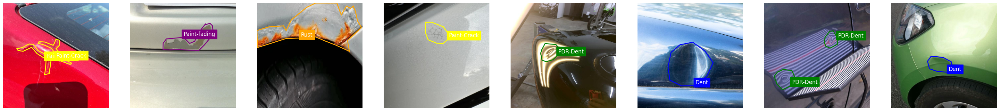

In [ ]:
# Example function call
display_images_with_annotations(data['train'])

# Trenowanie modelu YOLOv8
Skrypt trenuje model YOLOv8 na podstawie dostarczonego pliku konfiguracyjnego YAML

In [ ]:
# Train the YOLOv8 model with specified parameters
!yolo task=detect mode=train model=yolov8m.pt data="/content/data.yaml" epochs = 100 imgsz = 640 batch = -1

100% 49.7M/49.7M [00:01<00:00, 50.9MB/s]
Ultralytics YOLOv8.2.100 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/data.yaml, epochs=100, time=None, patience=100, batch=-1, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_cro

Wyniki trenowania modelu

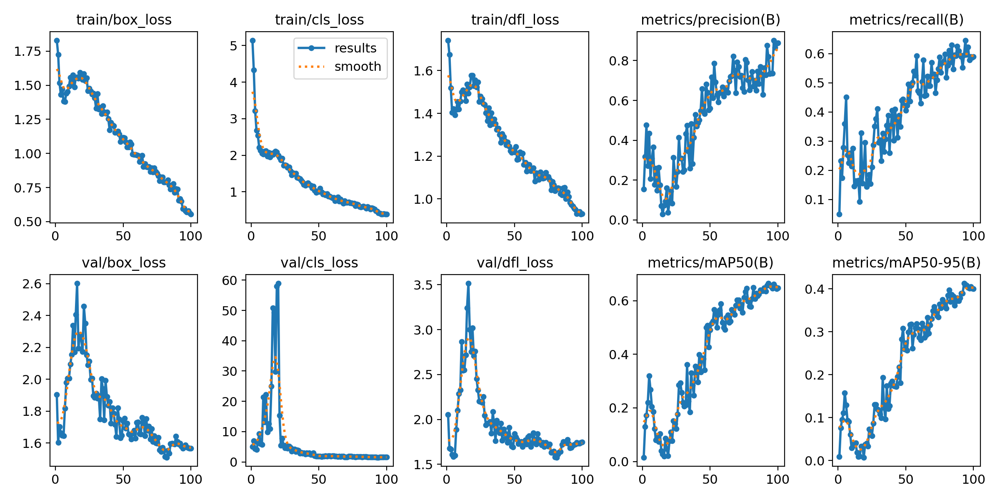

In [ ]:
# Display training results image
display(Image(filename='/content/runs/detect/train/results.png'))

Macierz pomyłek

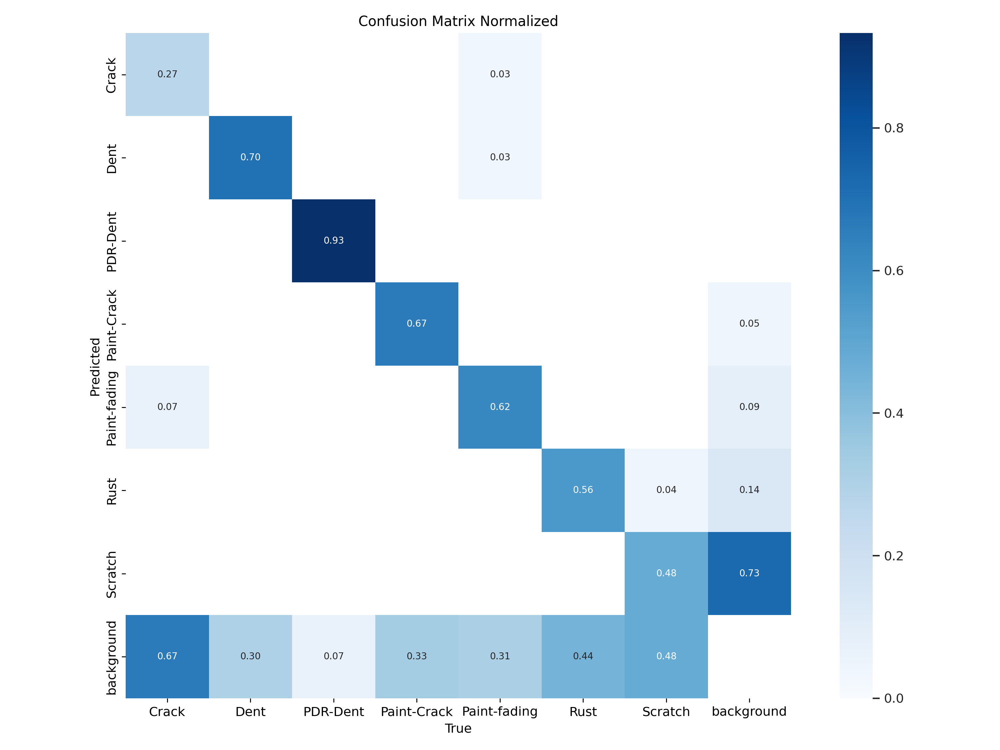

In [ ]:
# Display confusion matrix image
display(Image(filename='/content/runs/detect/train/confusion_matrix_normalized.png'))

# Ewaluacja modelu YOLOv8
Skrypt przeprowadza ewaluację wytrenowanego modelu YOLOv8, wczytując najlepsze wagi modelu oraz wyświetlając różne krzywe ewaluacyjne, takie jak krzywa F1, krzywa PR, krzywa precyzji oraz krzywa czułości, a także znormalizowaną macierz pomyłek.

In [ ]:
# Evaluate the YOLOv8 model with specified parameters
!yolo val model='/content/runs/detect/train/weights/best.pt' data='/content/data.yaml' imgsz=640

Ultralytics YOLOv8.2.100 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (NVIDIA A100-SXM4-40GB, 40514MiB)
Model summary (fused): 218 layers, 25,843,813 parameters, 0 gradients, 78.7 GFLOPs
val: Scanning /content/valid/labels.cache... 69 images, 0 backgrounds, 0 corrupt: 100% 69/69 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 5/5 [00:02<00:00,  2.28it/s]
                   all         69        141      0.821      0.595      0.664      0.414
                 Crack          7         15      0.879      0.267      0.398      0.303
                  Dent         10         10      0.962        0.8      0.846      0.607
              PDR-Dent         13         15      0.919      0.933      0.944       0.43
           Paint-Crack          5          6      0.877      0.667      0.811      0.553
          Paint-fading         15         29       0.78      0.586      0.681      0.473
                  Rust          9         18    

Krzywe ewaluacji

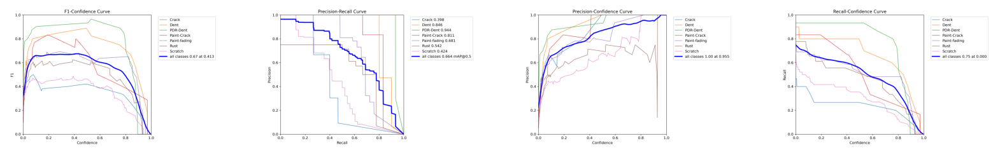

In [ ]:
# Sample paths to four evaluation images
img_paths = [
    '/content/runs/detect/val/F1_curve.png',
    '/content/runs/detect/val/PR_curve.png',
    '/content/runs/detect/val/P_curve.png',
    '/content/runs/detect/val/R_curve.png'
]

# Create a subplot with 1 row and 4 columns
fig, axs = plt.subplots(1, 4, figsize=(20, 5))  # Adjust the figure size as needed

# Display each image in the subplot
for ax, img_path in zip(axs, img_paths):
    img = PILImage.open(img_path)
    ax.imshow(img)
    ax.axis('off')  # Turn off the axis for better readability
plt.show()

Macierz pomyłek

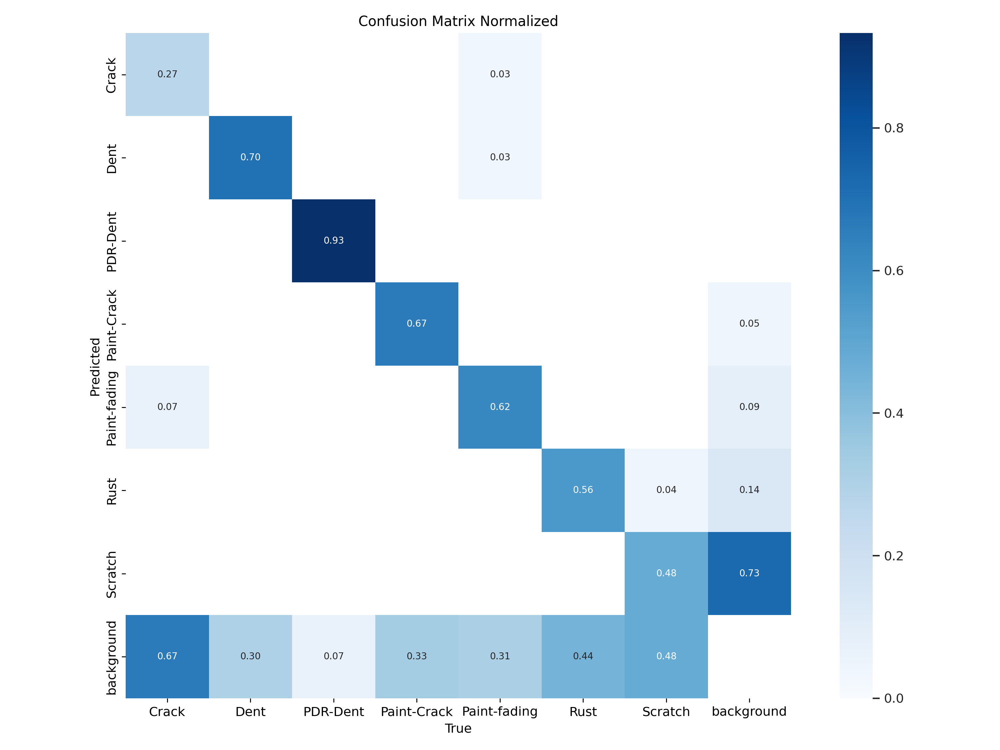

In [ ]:
# Display the confusion matrix image
display(Image(filename='/content/runs/detect/val/confusion_matrix_normalized.png'))

# Ładowanie i predykcja za pomocą modelu YOLOv8
Skrypt ładuje wytrenowany model YOLOv8 i przeprowadza predykcje na zbiorze testowym. Na obrazach są rysowane ramki graniczne oraz etykiety dla wykrytych obiektów, które są następnie wyświetlane.


0: 640x640 1 Scratch, 11.8ms
Speed: 7.7ms preprocess, 11.8ms inference, 516.3ms postprocess per image at shape (1, 3, 640, 640)


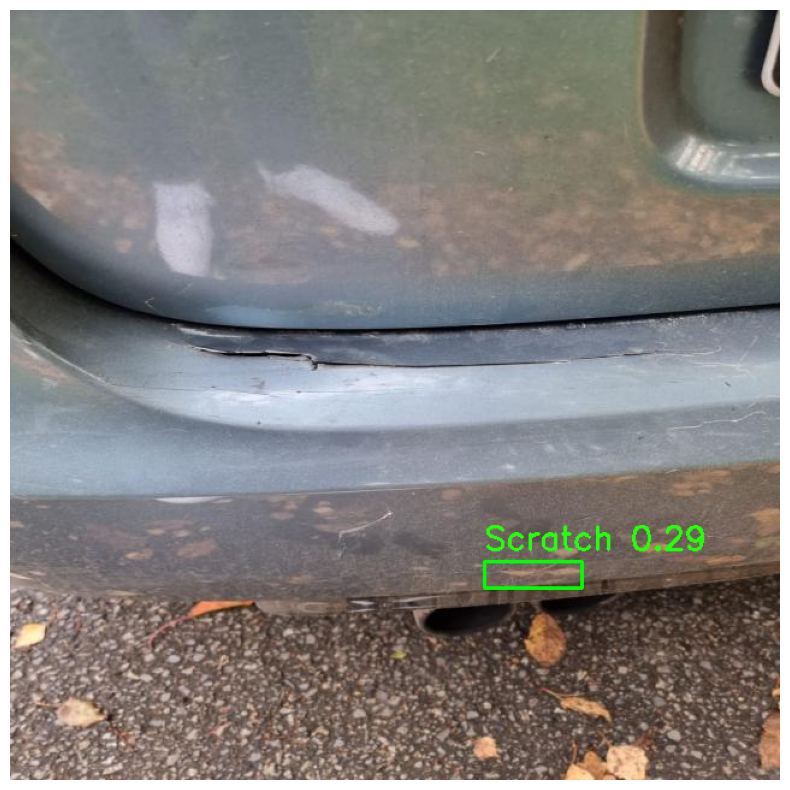


0: 640x640 1 Paint-Crack, 12.0ms
Speed: 1.7ms preprocess, 12.0ms inference, 28.9ms postprocess per image at shape (1, 3, 640, 640)


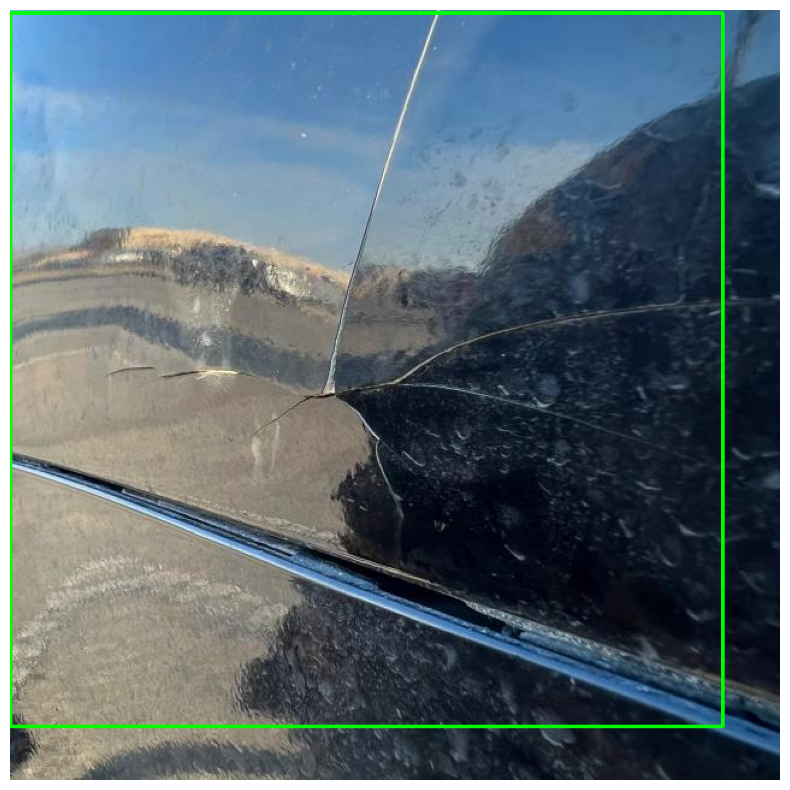


0: 640x640 1 Rust, 1 Scratch, 10.2ms
Speed: 1.6ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


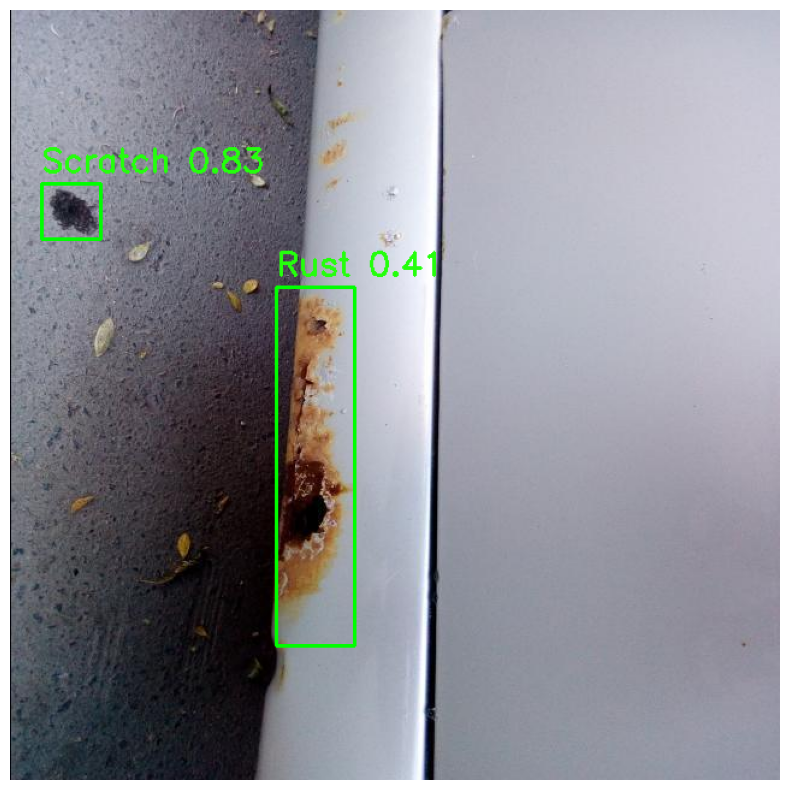


0: 640x640 1 Crack, 2 Scratchs, 10.1ms
Speed: 1.6ms preprocess, 10.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


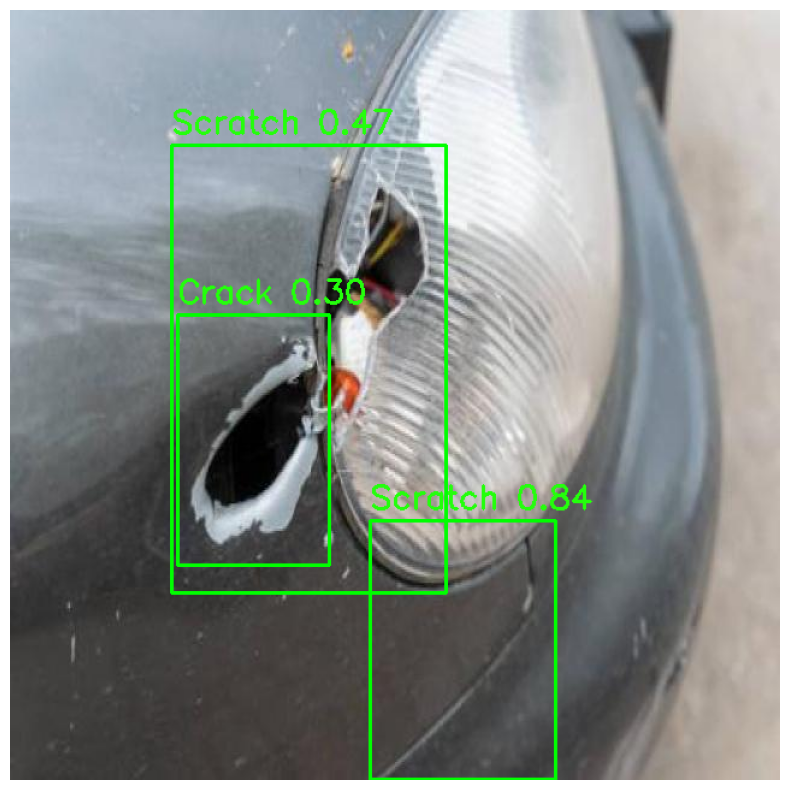


0: 640x640 (no detections), 12.8ms
Speed: 1.7ms preprocess, 12.8ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


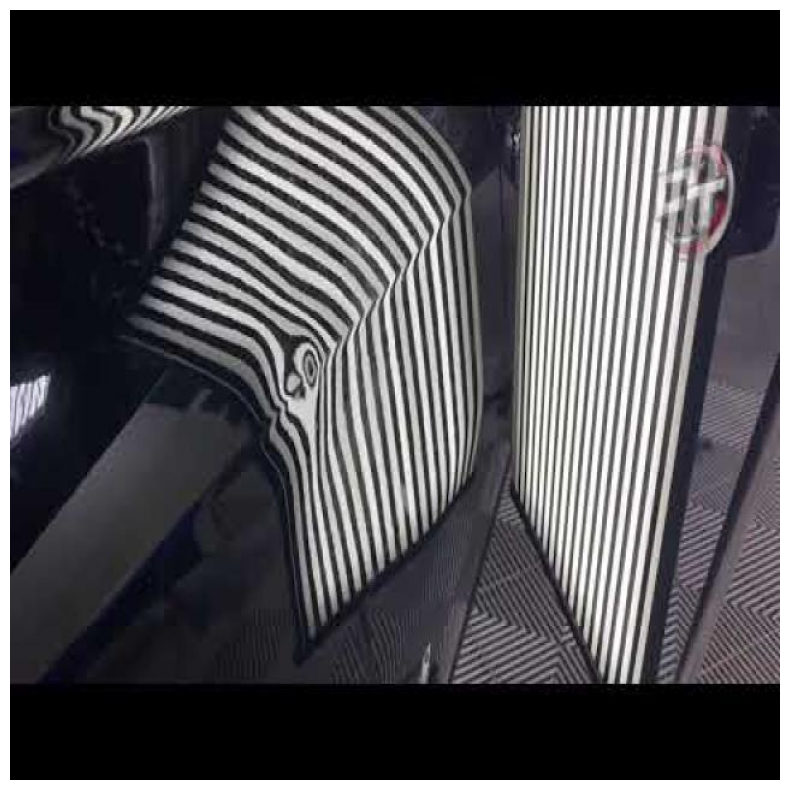


0: 640x640 3 PDR-Dents, 10.4ms
Speed: 1.7ms preprocess, 10.4ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


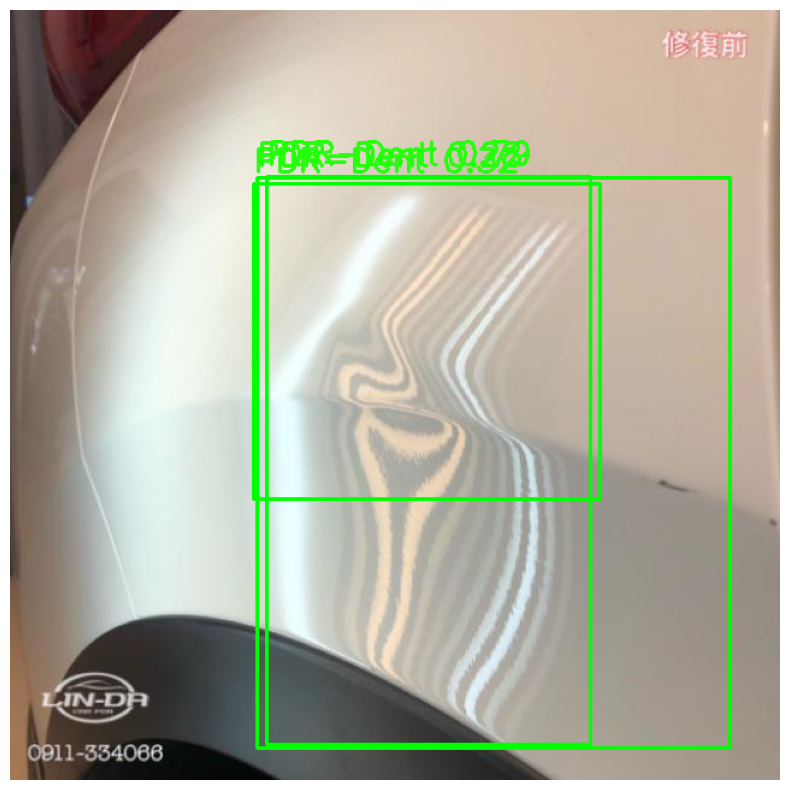


0: 640x640 2 Cracks, 10.3ms
Speed: 1.7ms preprocess, 10.3ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


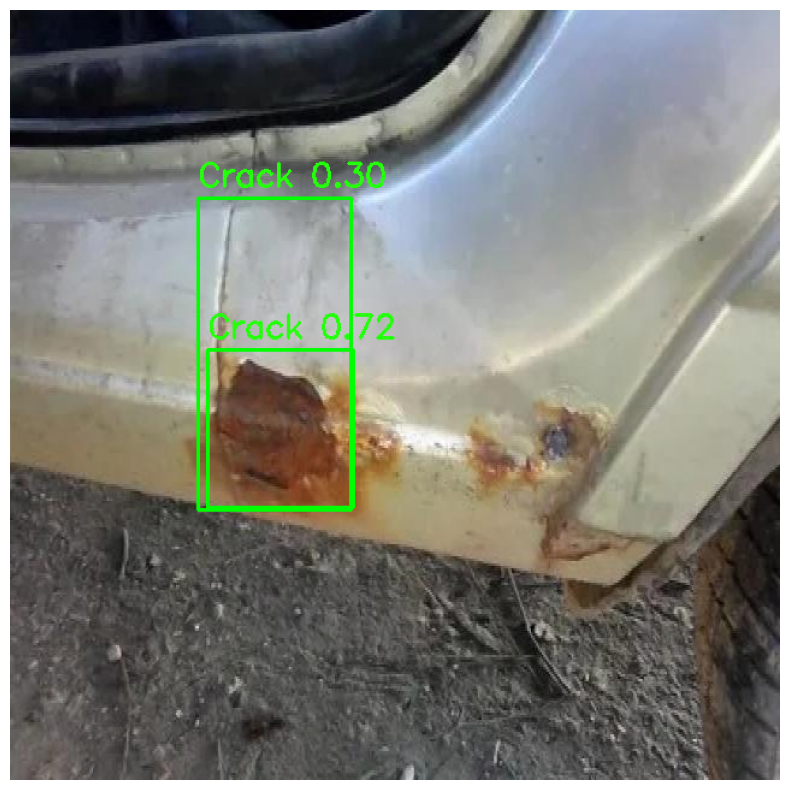


0: 640x640 1 Paint-fading, 10.5ms
Speed: 1.7ms preprocess, 10.5ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


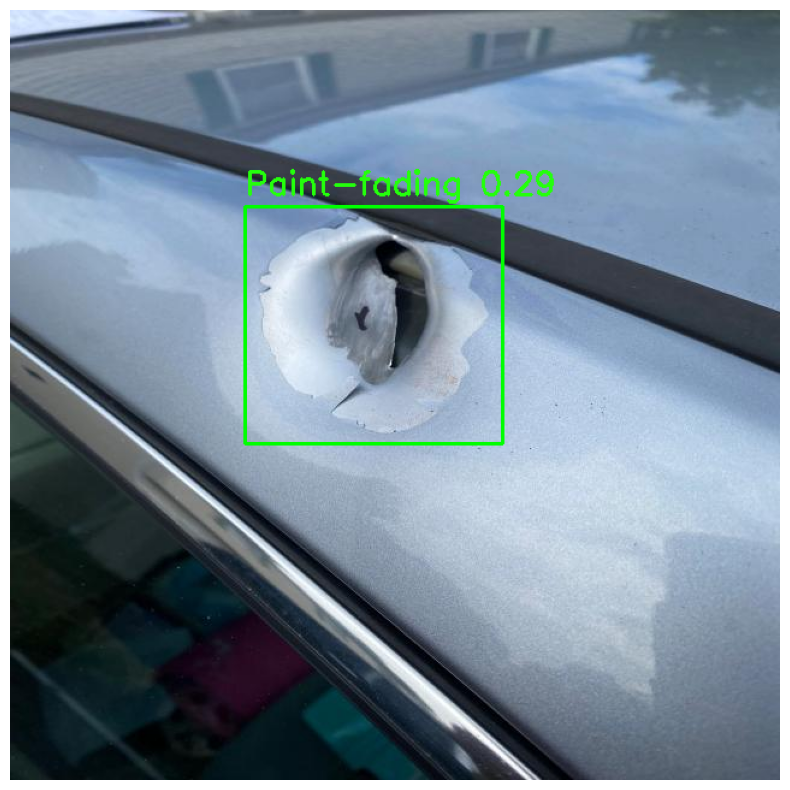


0: 640x640 2 Scratchs, 10.1ms
Speed: 1.7ms preprocess, 10.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


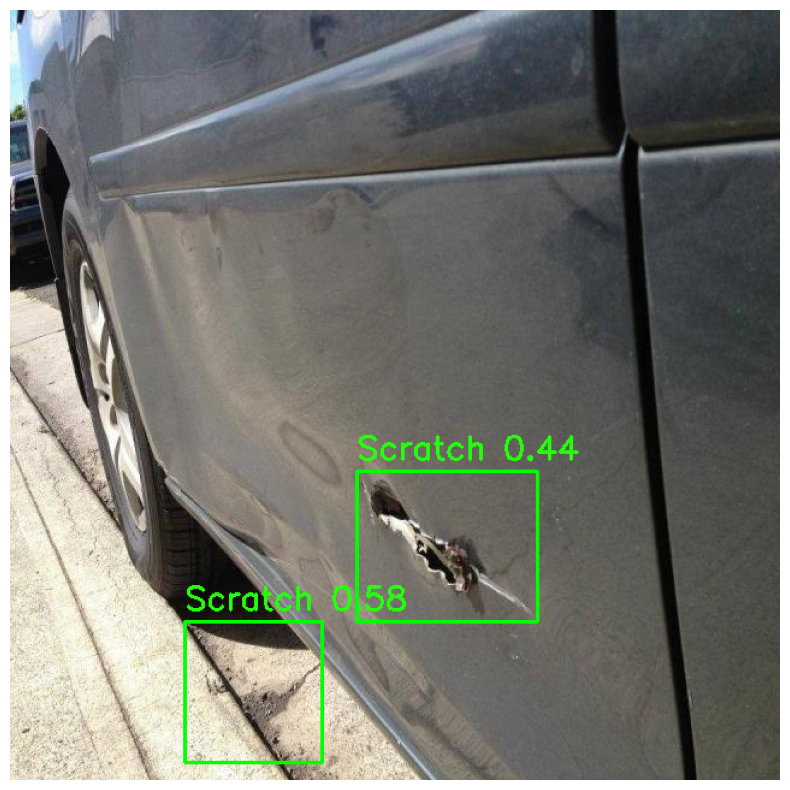


0: 640x640 1 Rust, 11.7ms
Speed: 1.8ms preprocess, 11.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


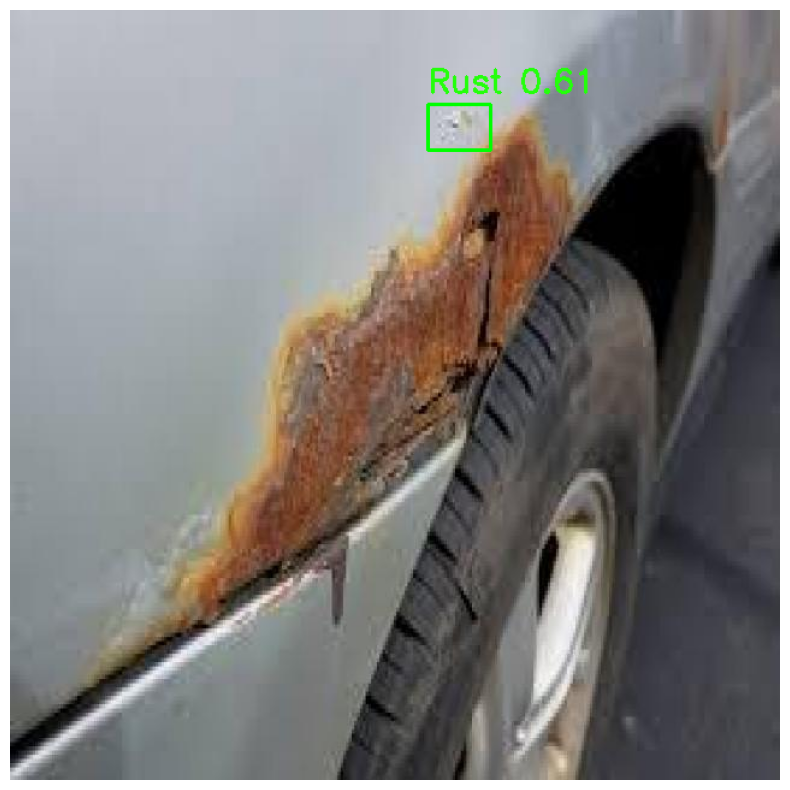


0: 640x640 3 PDR-Dents, 1 Rust, 12.9ms
Speed: 1.7ms preprocess, 12.9ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


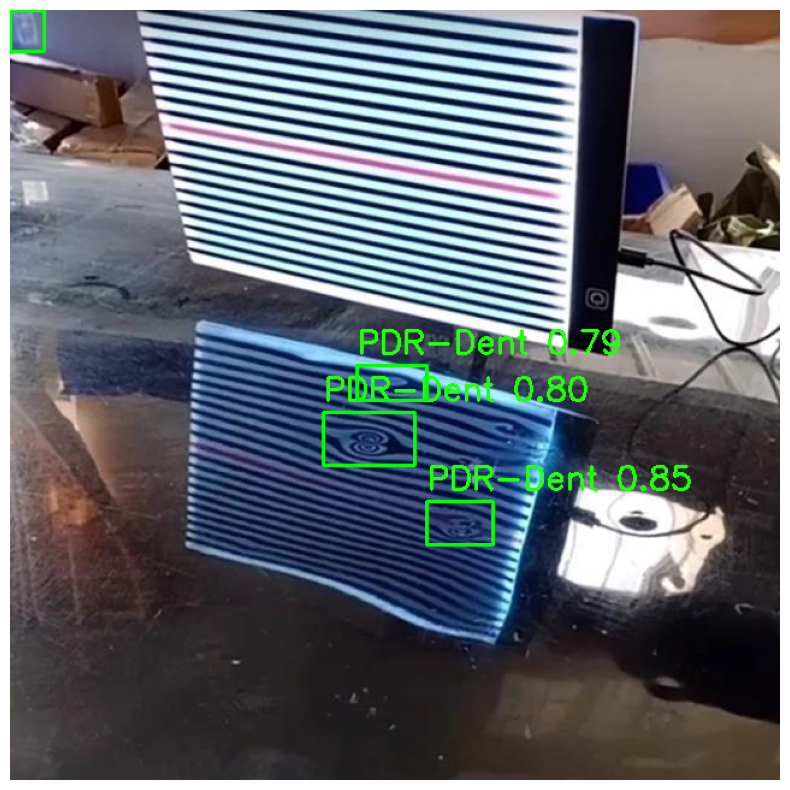


0: 640x640 1 Paint-fading, 11.0ms
Speed: 1.8ms preprocess, 11.0ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


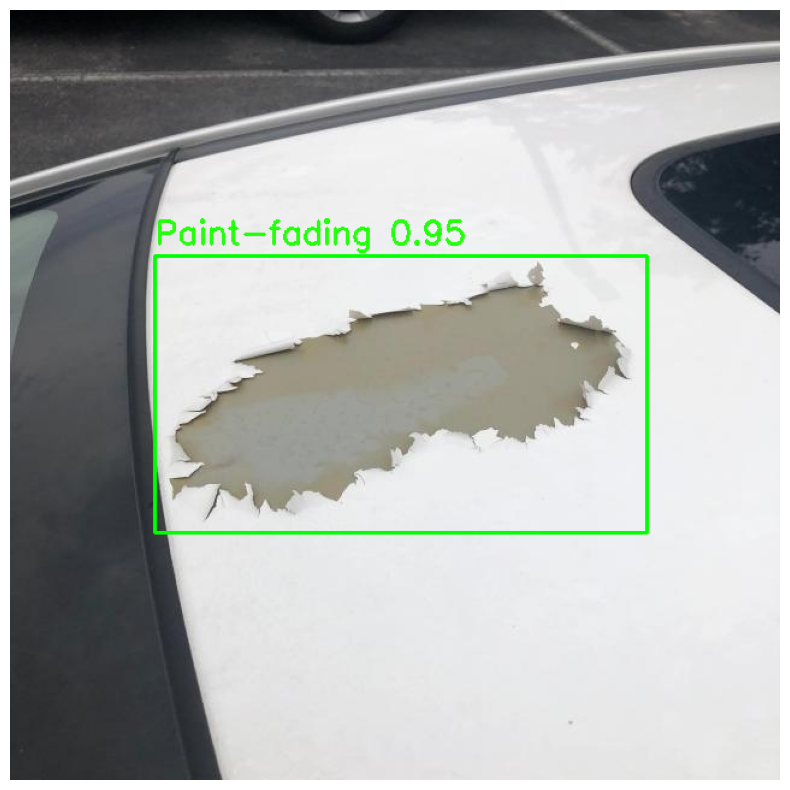


0: 640x640 4 Rusts, 10.2ms
Speed: 2.3ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


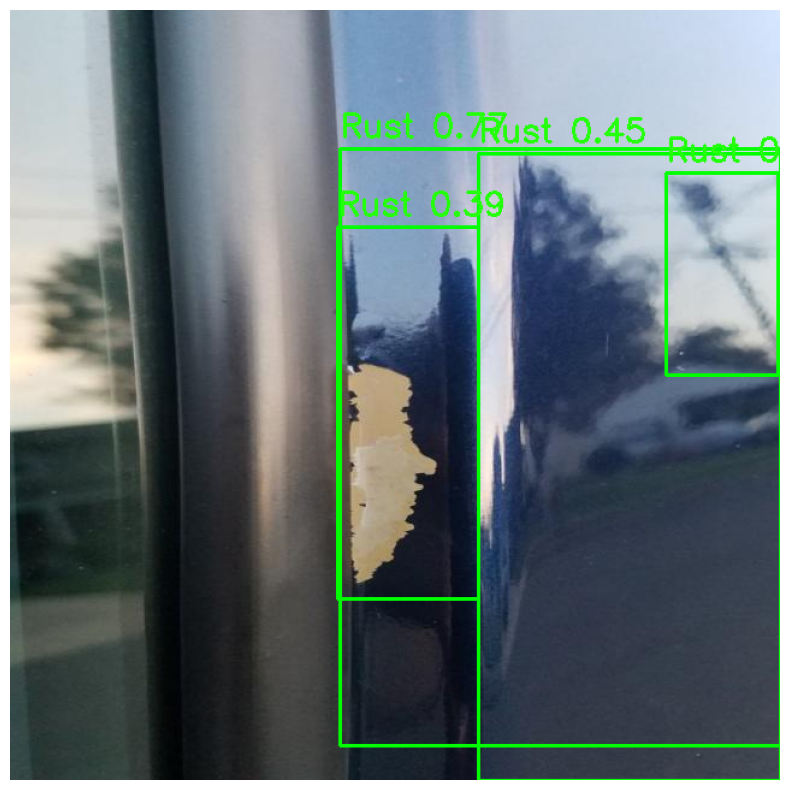


0: 640x640 (no detections), 10.1ms
Speed: 1.7ms preprocess, 10.1ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


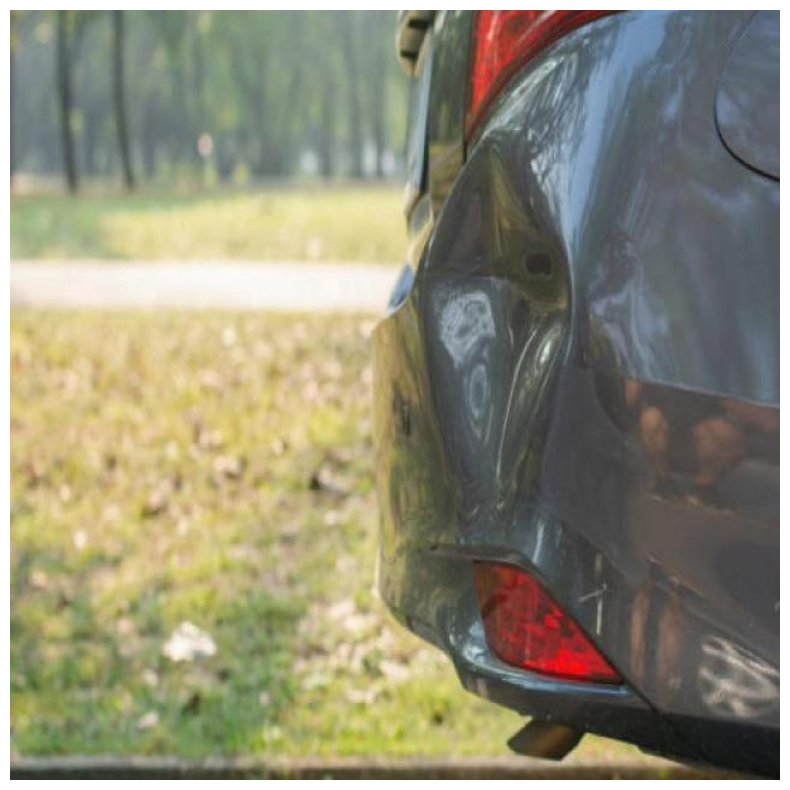


0: 640x640 1 Paint-fading, 13.7ms
Speed: 1.7ms preprocess, 13.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


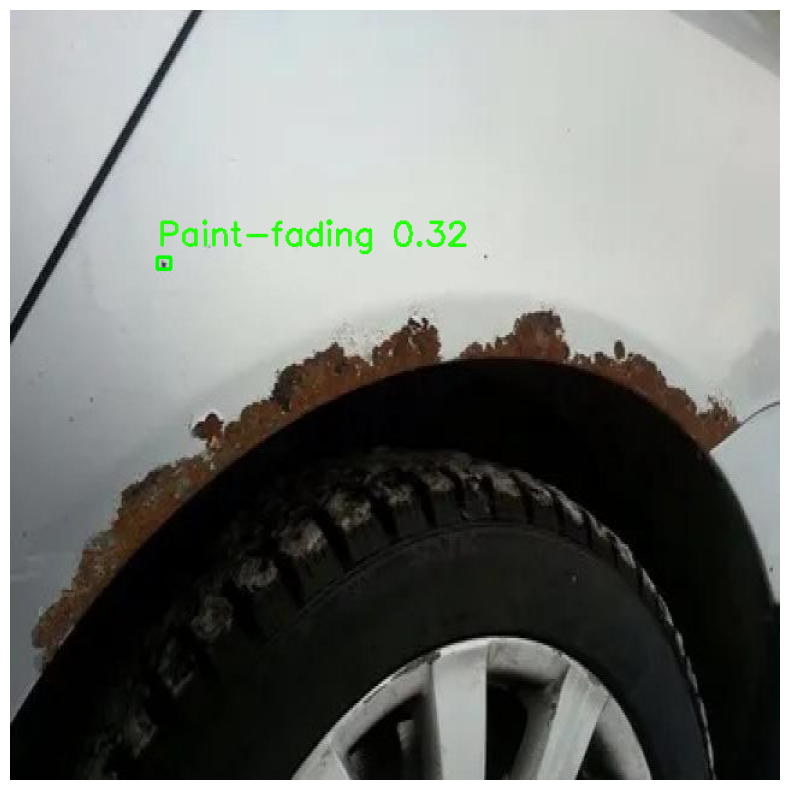


0: 640x640 1 Dent, 1 Scratch, 10.1ms
Speed: 1.8ms preprocess, 10.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


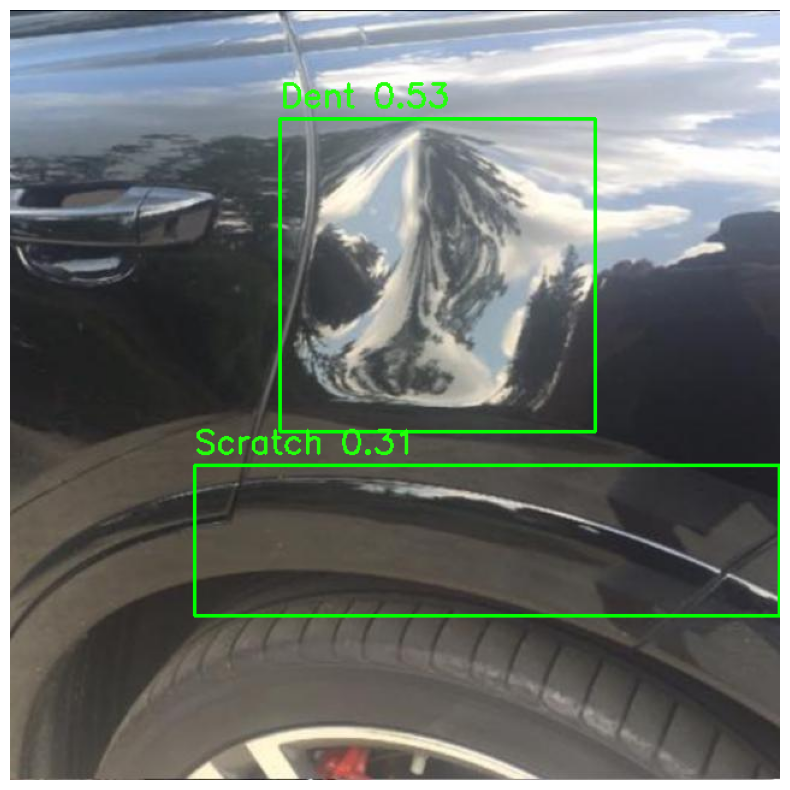


0: 640x640 1 PDR-Dent, 10.3ms
Speed: 1.7ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


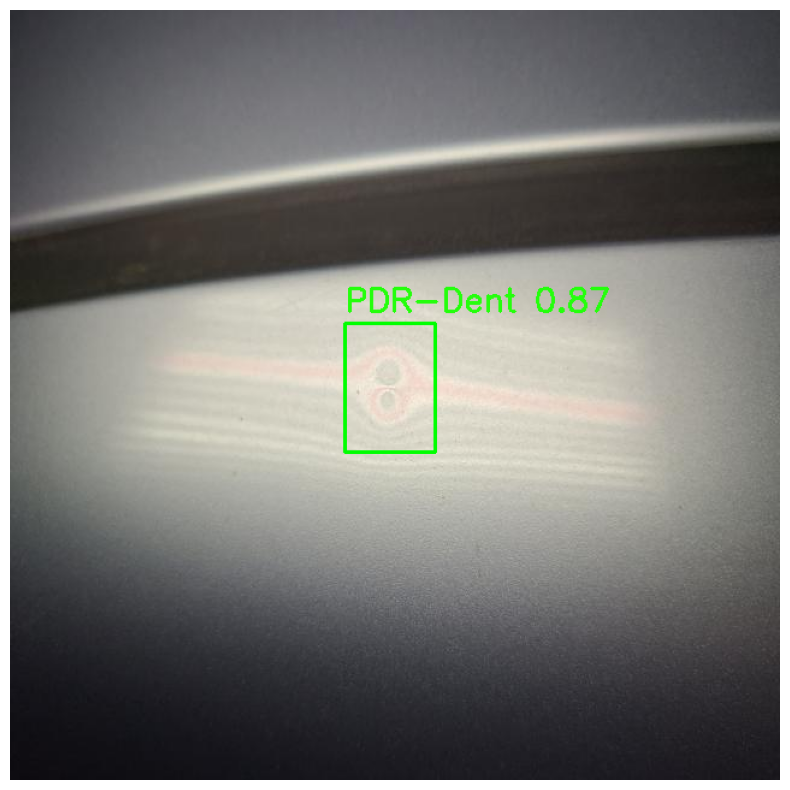


0: 640x640 1 Scratch, 10.3ms
Speed: 1.8ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


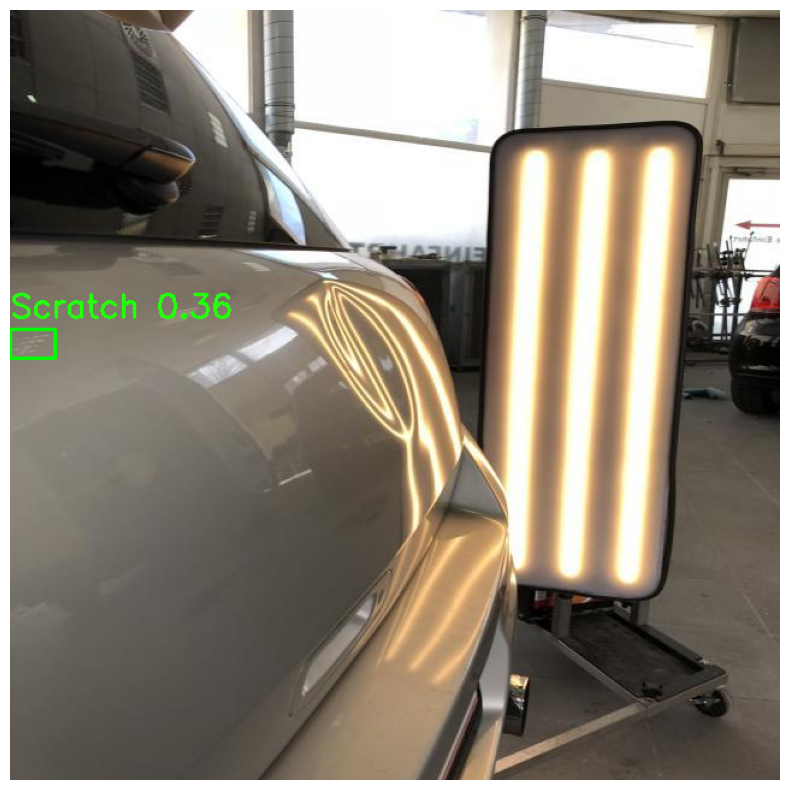


0: 640x640 1 PDR-Dent, 10.7ms
Speed: 2.0ms preprocess, 10.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


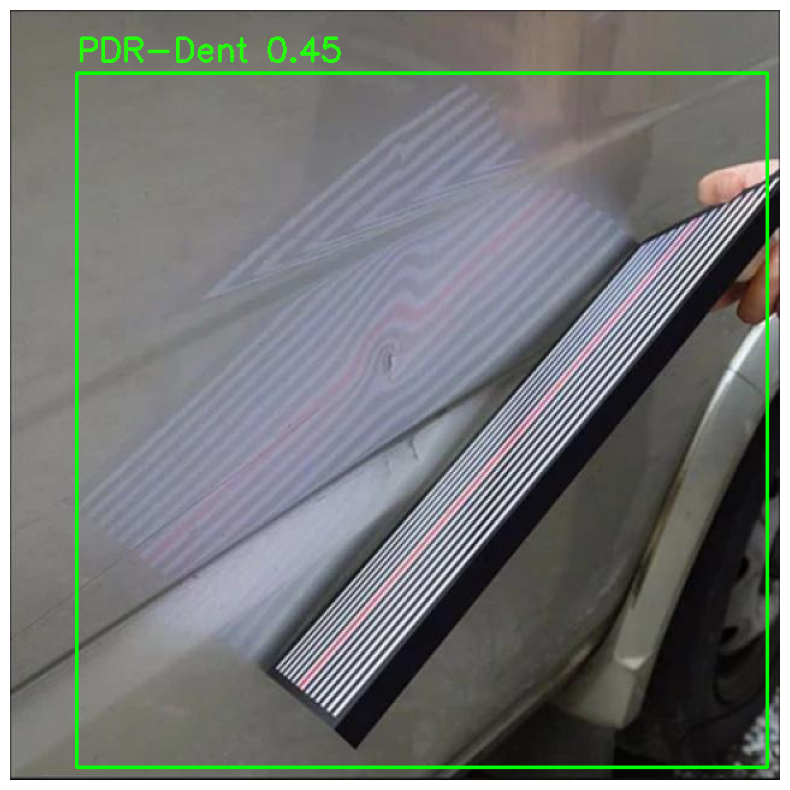


0: 640x640 1 Scratch, 10.8ms
Speed: 2.0ms preprocess, 10.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


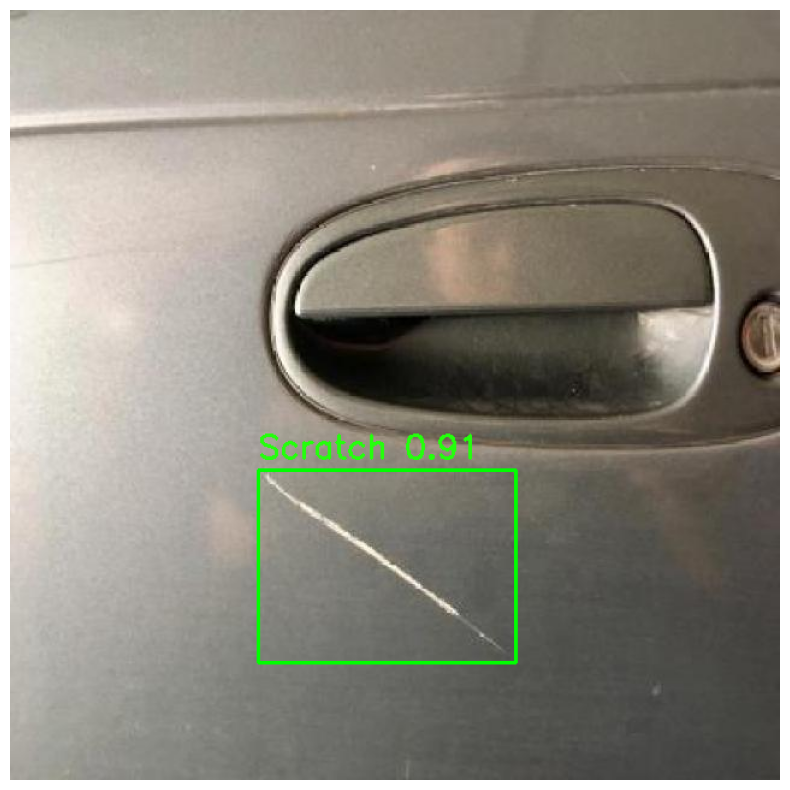


0: 640x640 1 Paint-fading, 1 Rust, 1 Scratch, 10.7ms
Speed: 1.8ms preprocess, 10.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


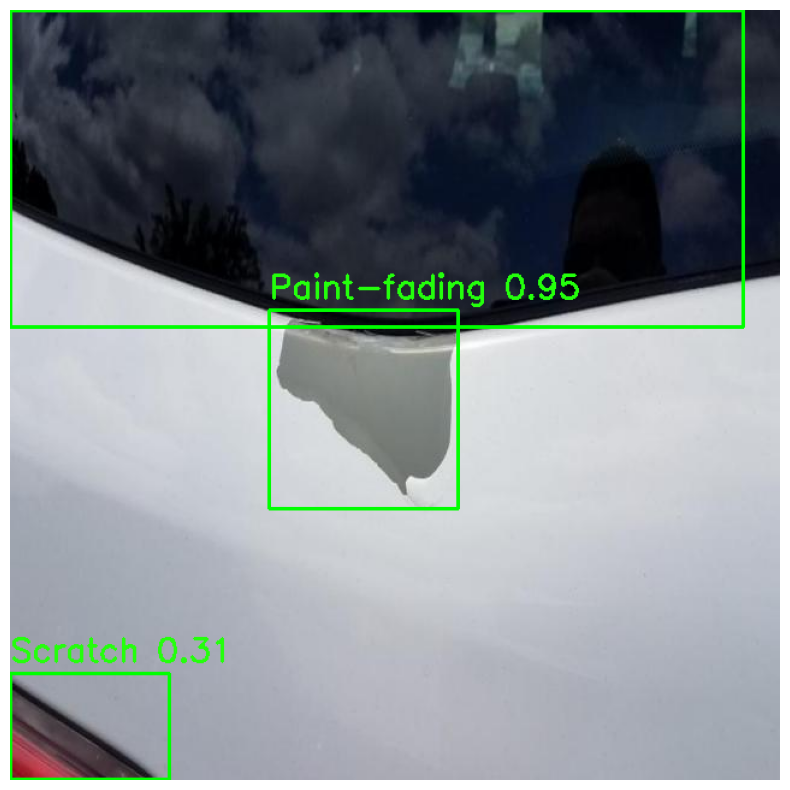


0: 640x640 (no detections), 10.6ms
Speed: 1.7ms preprocess, 10.6ms inference, 0.7ms postprocess per image at shape (1, 3, 640, 640)


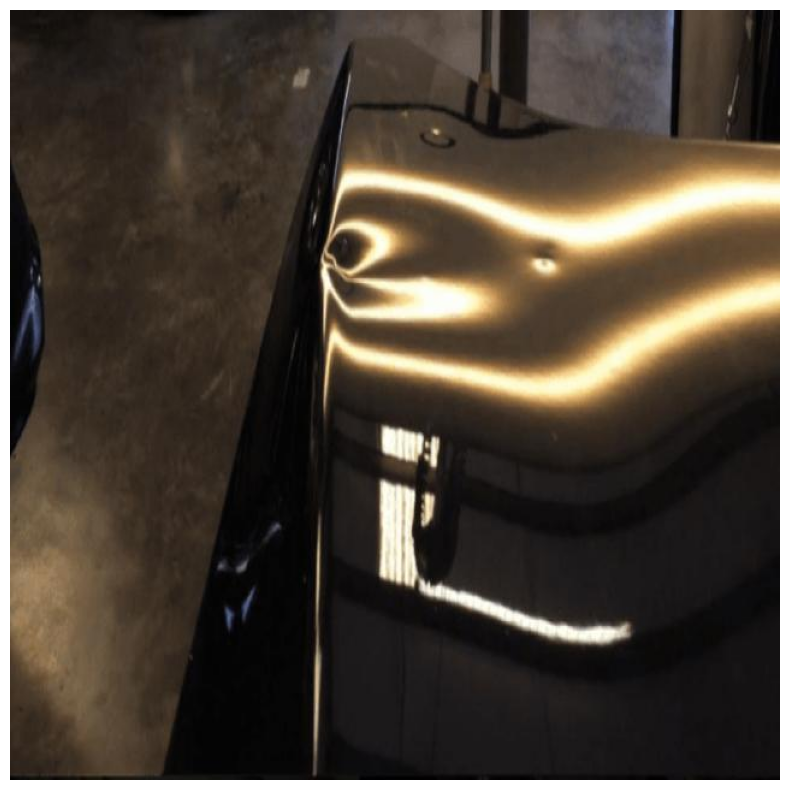


0: 640x640 (no detections), 10.2ms
Speed: 1.6ms preprocess, 10.2ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


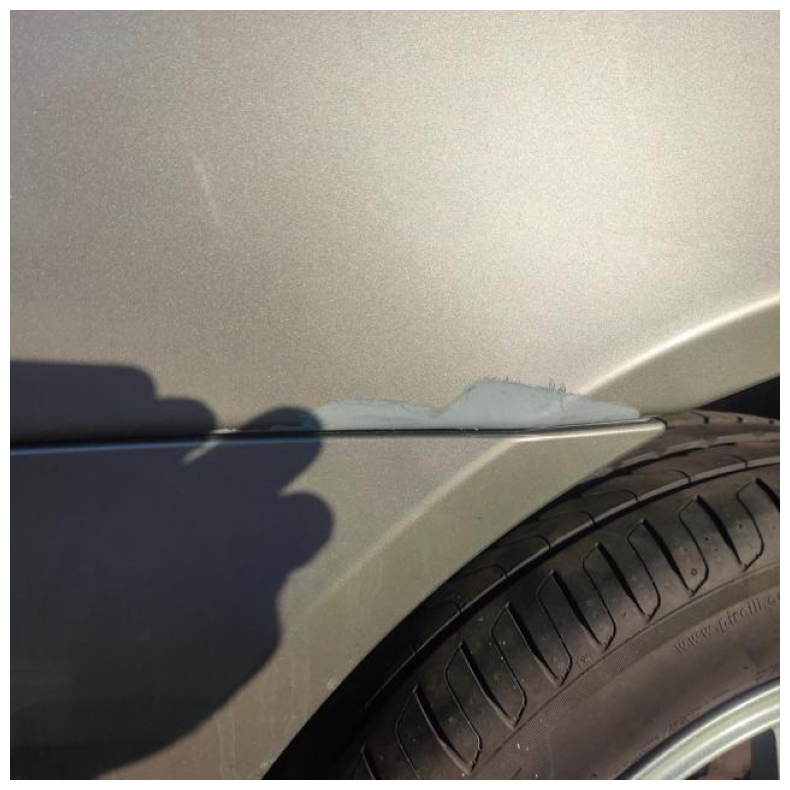


0: 640x640 1 Dent, 10.1ms
Speed: 1.7ms preprocess, 10.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


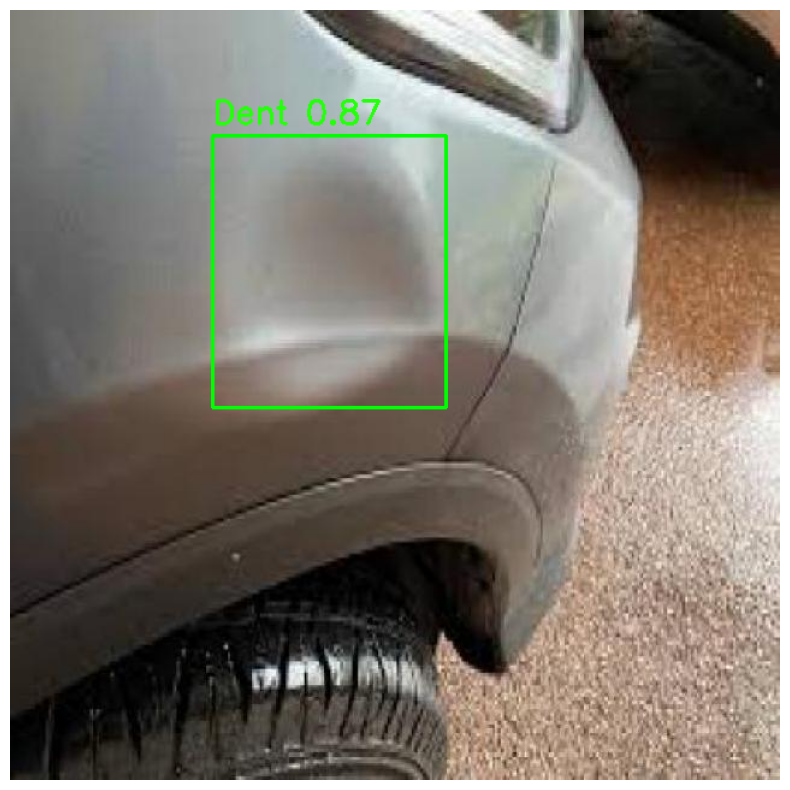


0: 640x640 (no detections), 10.3ms
Speed: 2.2ms preprocess, 10.3ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


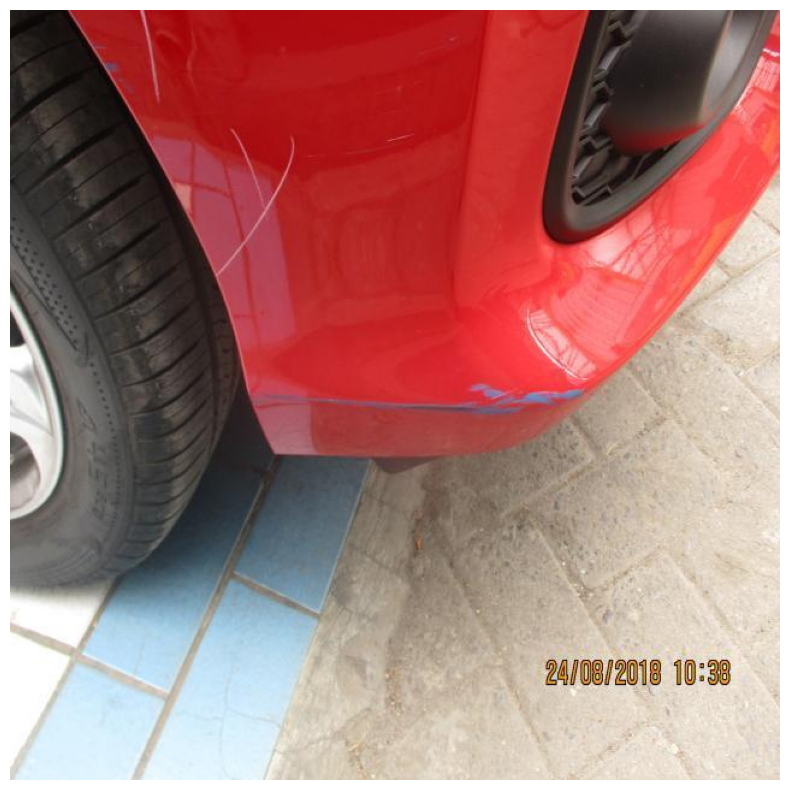


0: 640x640 1 Crack, 1 Paint-Crack, 10.2ms
Speed: 1.7ms preprocess, 10.2ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


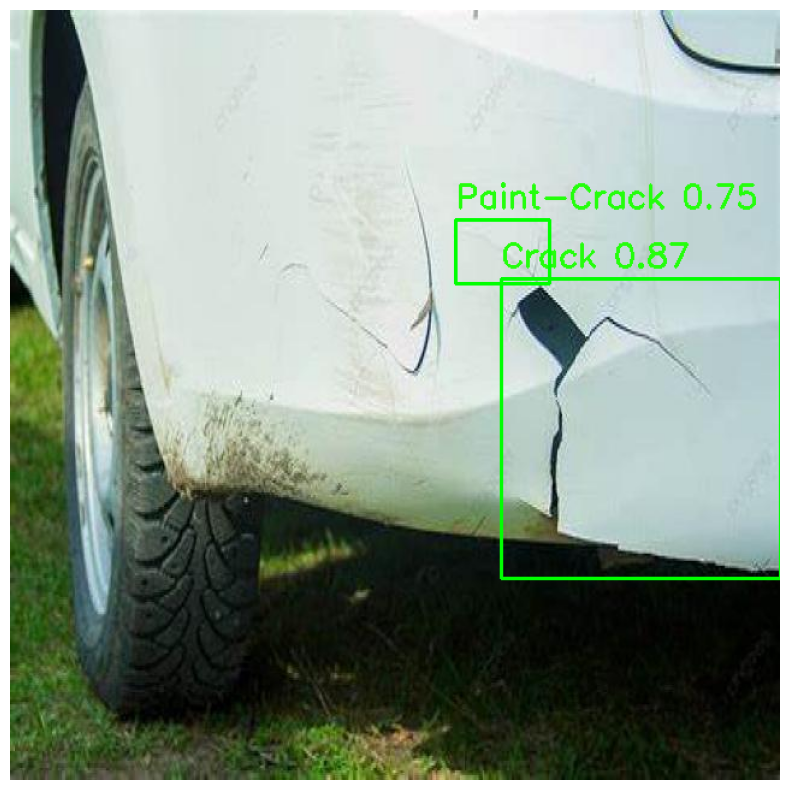


0: 640x640 (no detections), 9.8ms
Speed: 1.6ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


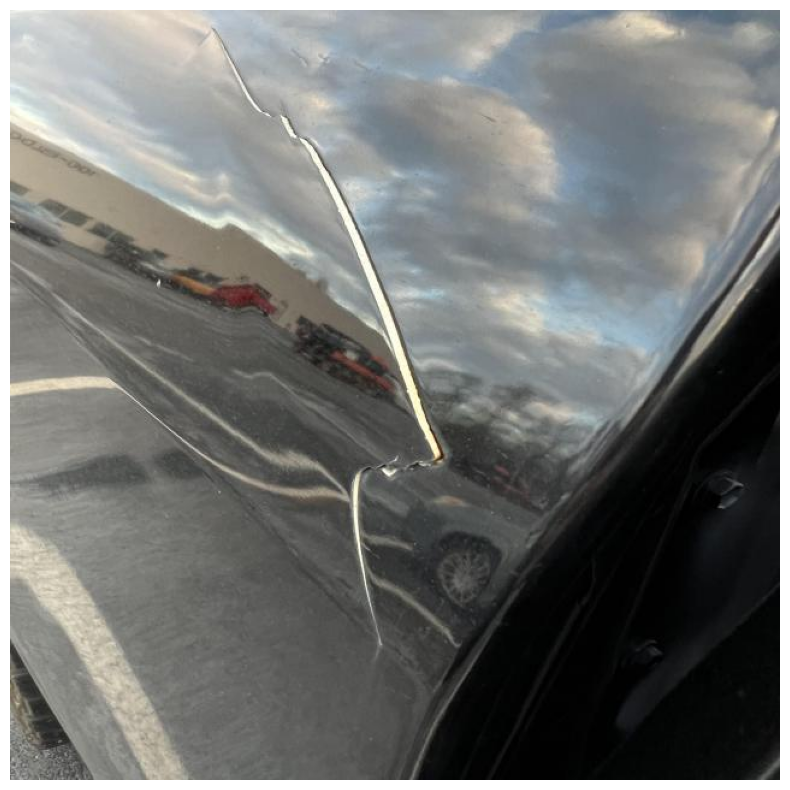


0: 640x640 2 Scratchs, 10.3ms
Speed: 1.6ms preprocess, 10.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


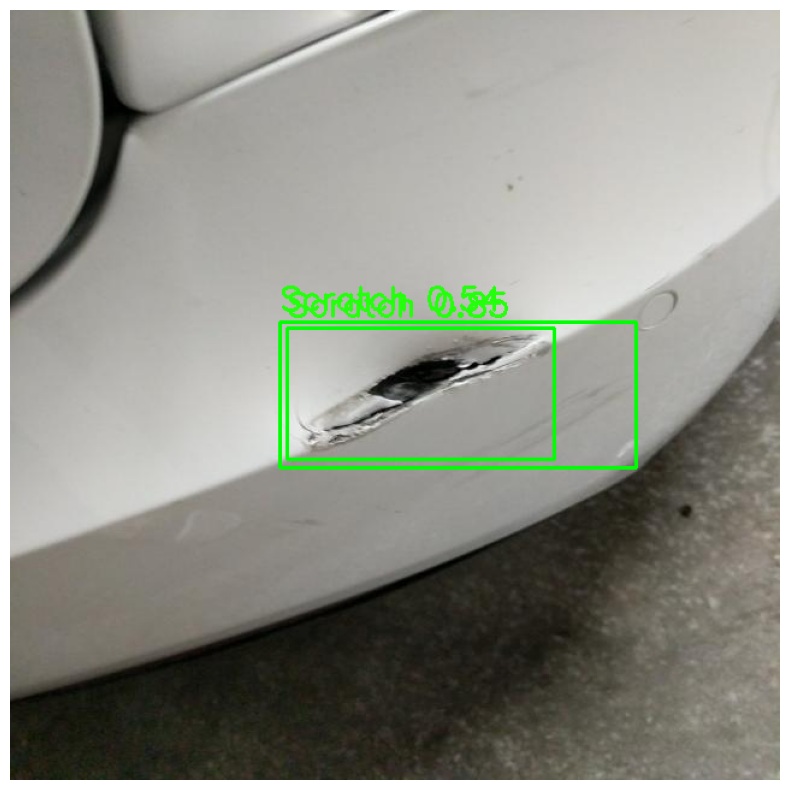


0: 640x640 1 Crack, 2 Dents, 1 Rust, 10.0ms
Speed: 1.7ms preprocess, 10.0ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


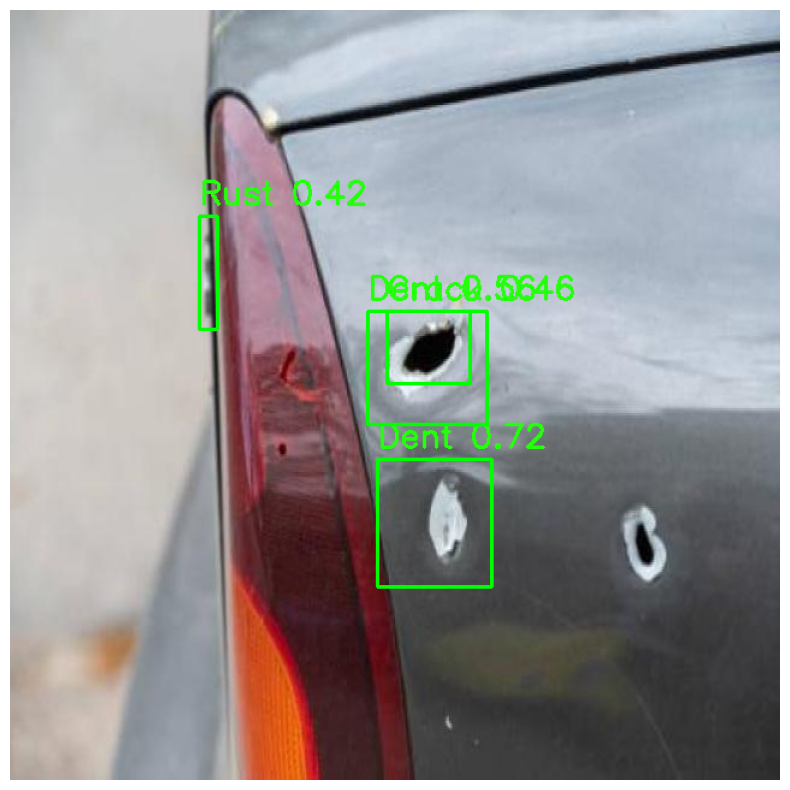


0: 640x640 1 Paint-Crack, 10.2ms
Speed: 1.7ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


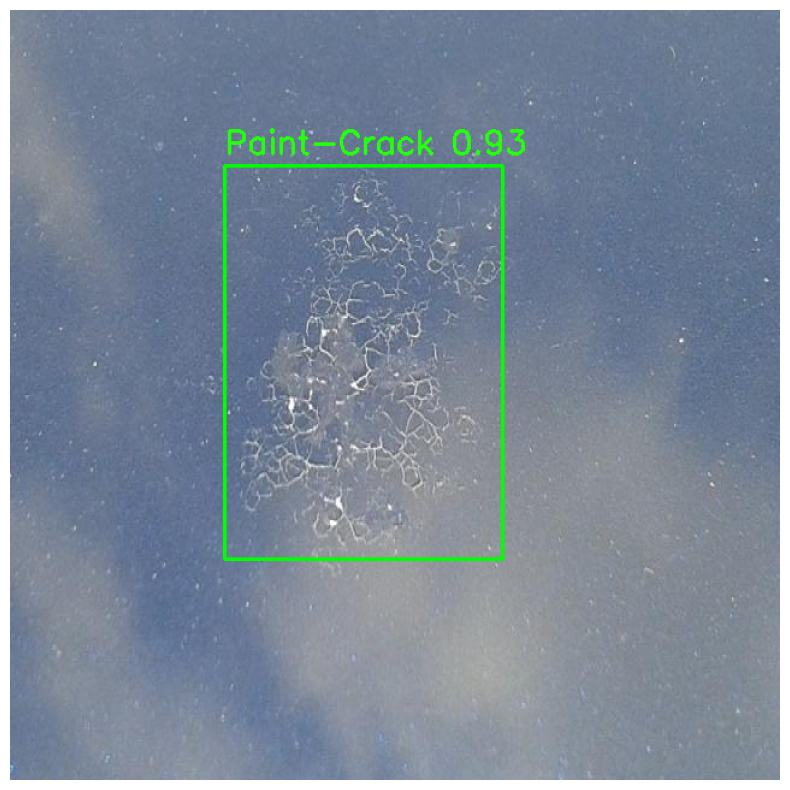


0: 640x640 1 Crack, 11.8ms
Speed: 1.7ms preprocess, 11.8ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


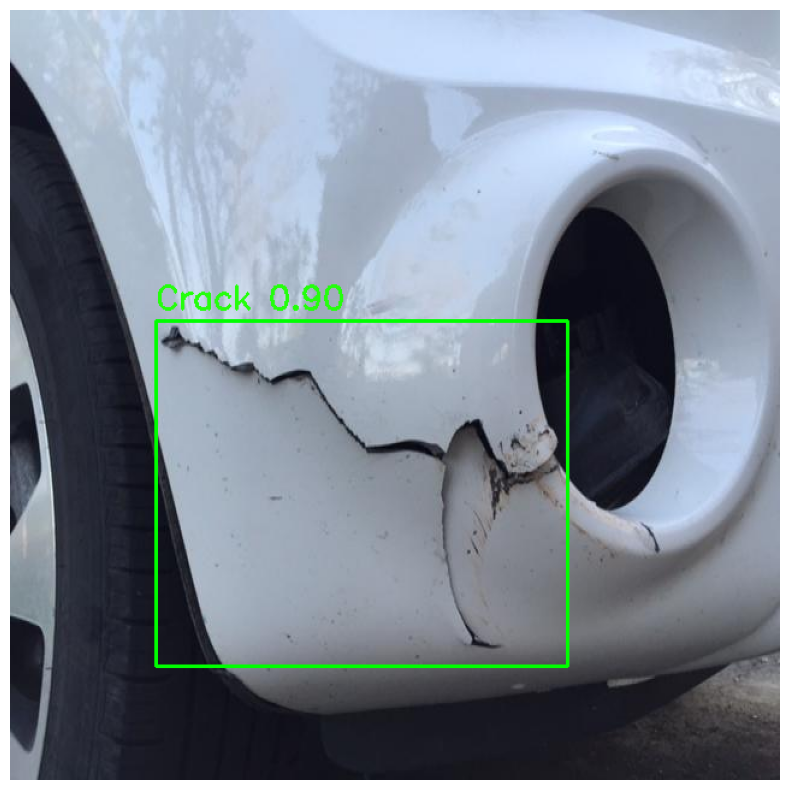


0: 640x640 1 Dent, 13.9ms
Speed: 1.7ms preprocess, 13.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


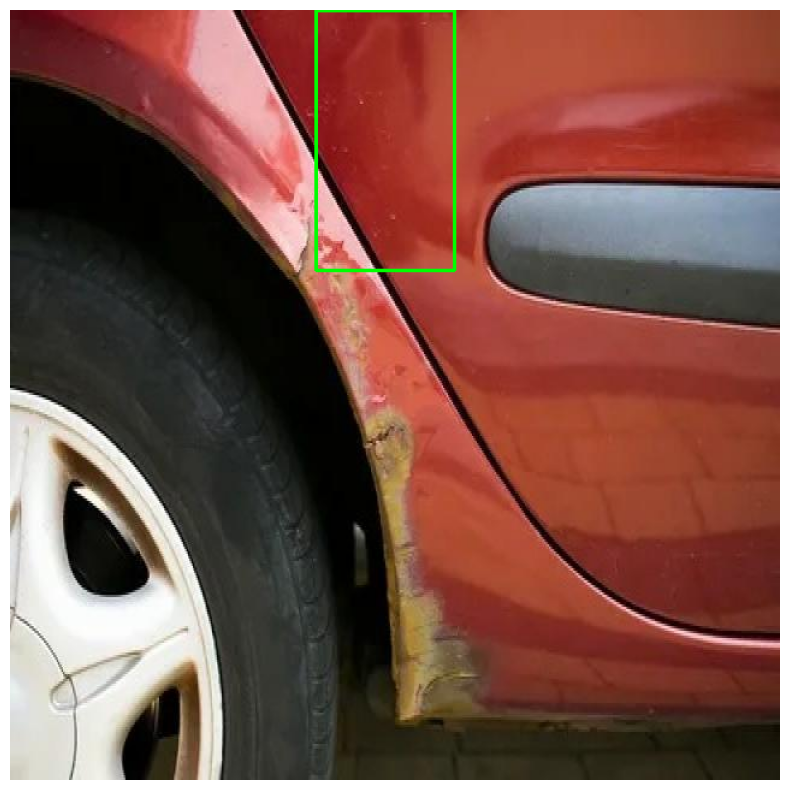


0: 640x640 2 Cracks, 1 Rust, 11.3ms
Speed: 1.7ms preprocess, 11.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


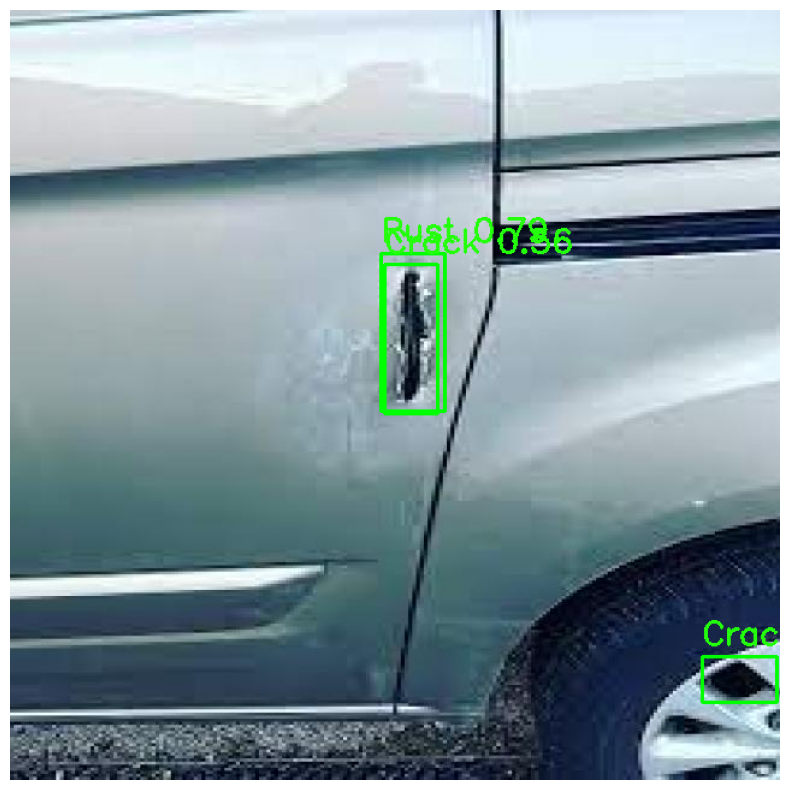


0: 640x640 1 Paint-Crack, 12.7ms
Speed: 1.8ms preprocess, 12.7ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


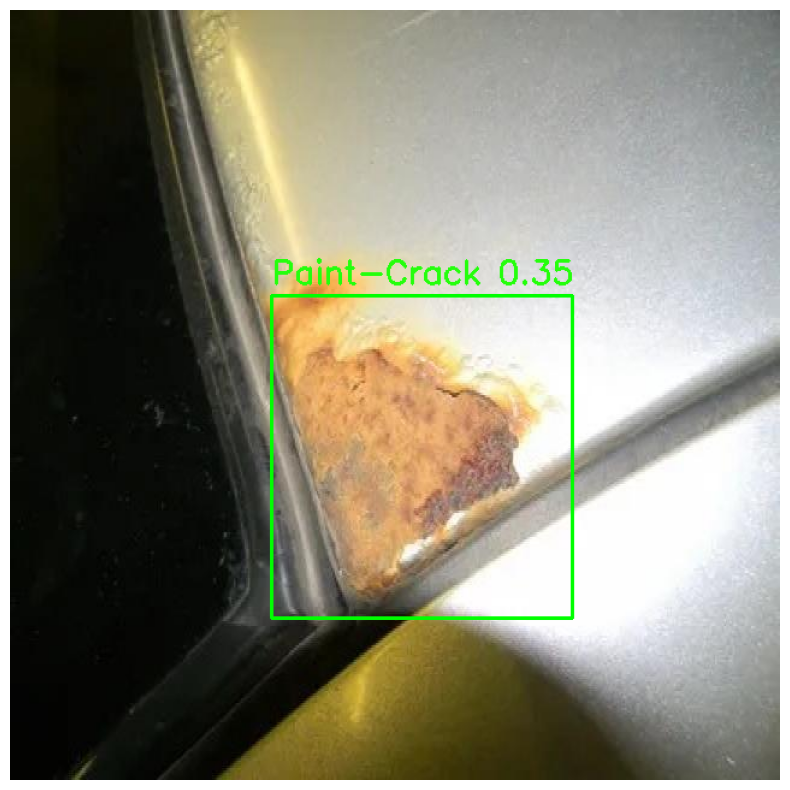


0: 640x640 1 Crack, 10.1ms
Speed: 1.7ms preprocess, 10.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


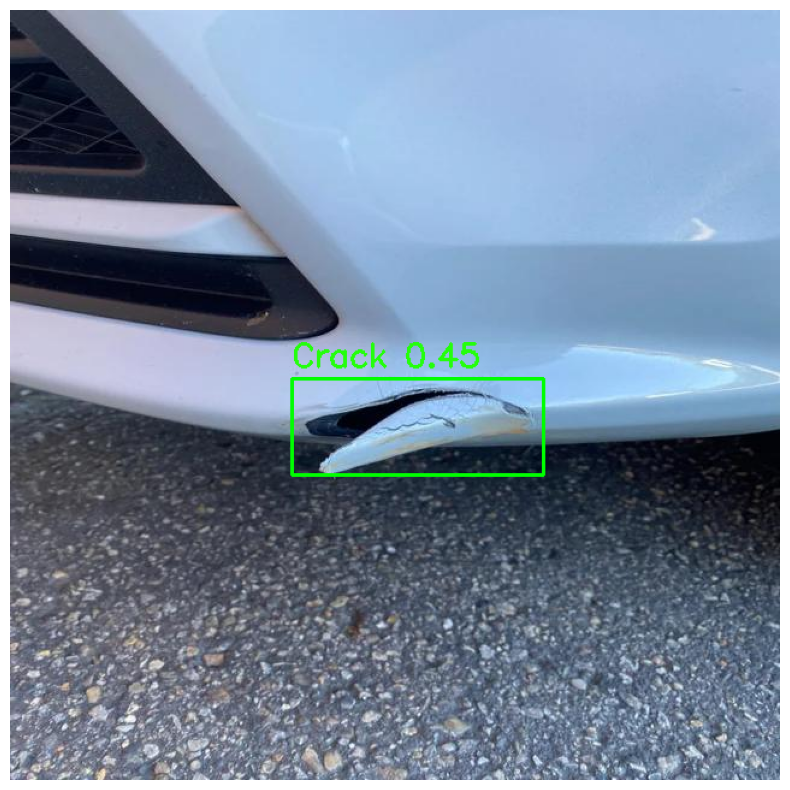


0: 640x640 3 Paint-Cracks, 1 Scratch, 10.2ms
Speed: 2.1ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


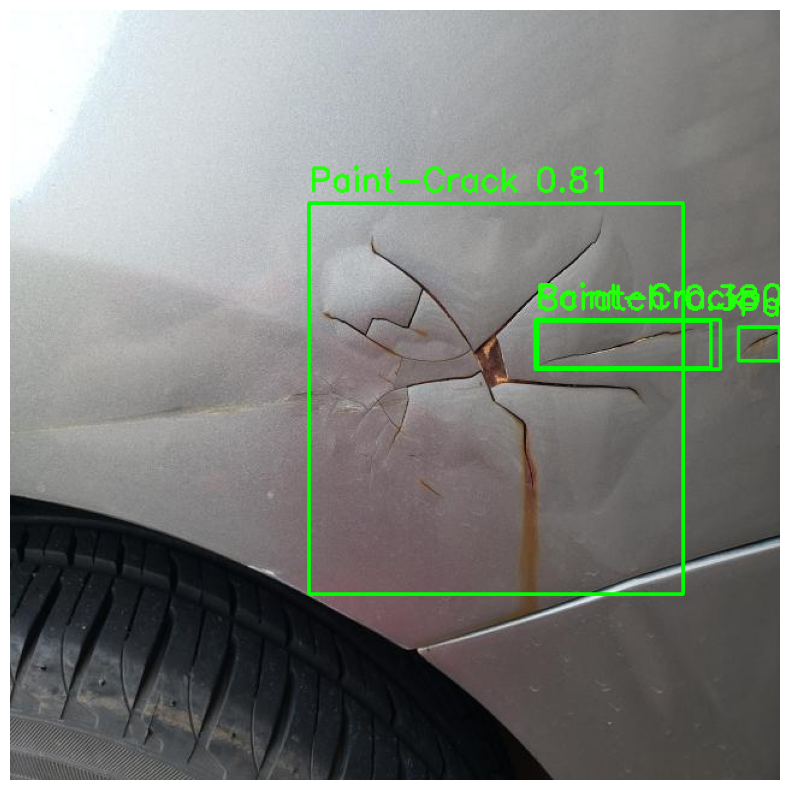


0: 640x640 1 Dent, 5 Scratchs, 10.4ms
Speed: 1.7ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


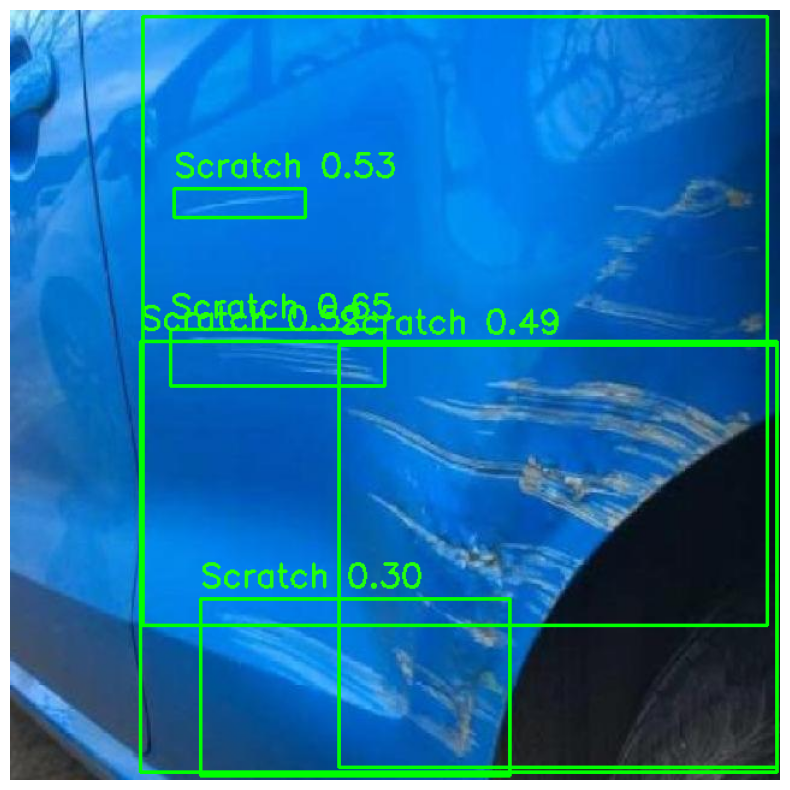


0: 640x640 2 Paint-fadings, 1 Scratch, 9.9ms
Speed: 1.7ms preprocess, 9.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


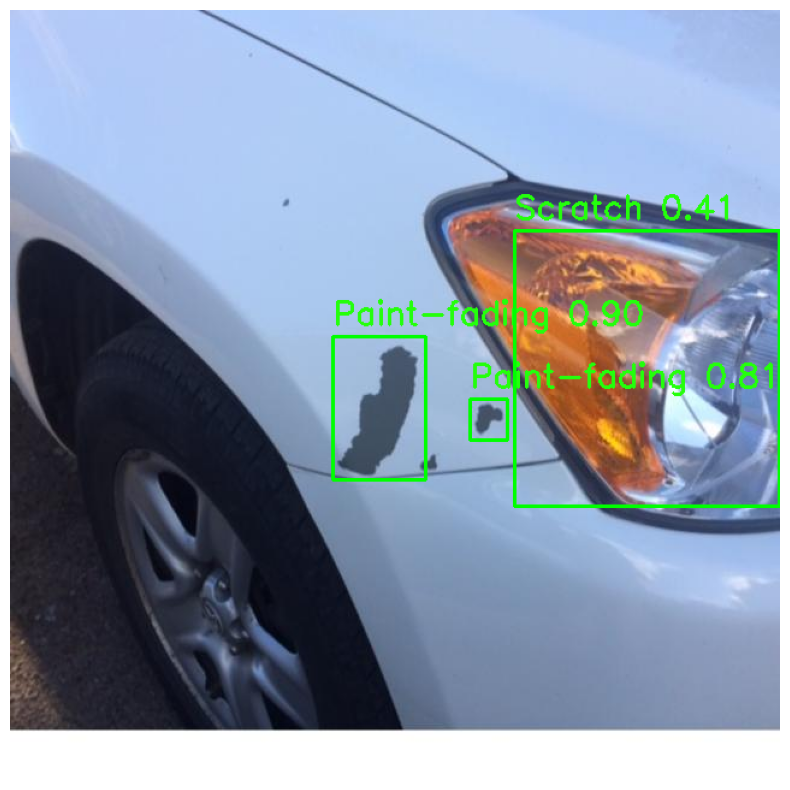


0: 640x640 (no detections), 9.8ms
Speed: 2.0ms preprocess, 9.8ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)


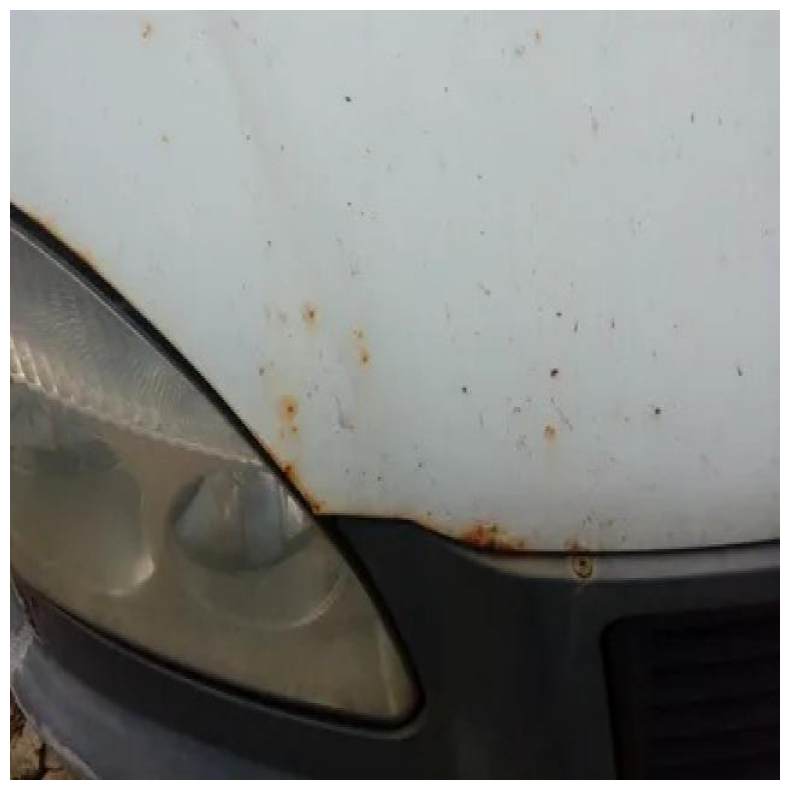


0: 640x640 3 Paint-Cracks, 9.8ms
Speed: 2.0ms preprocess, 9.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


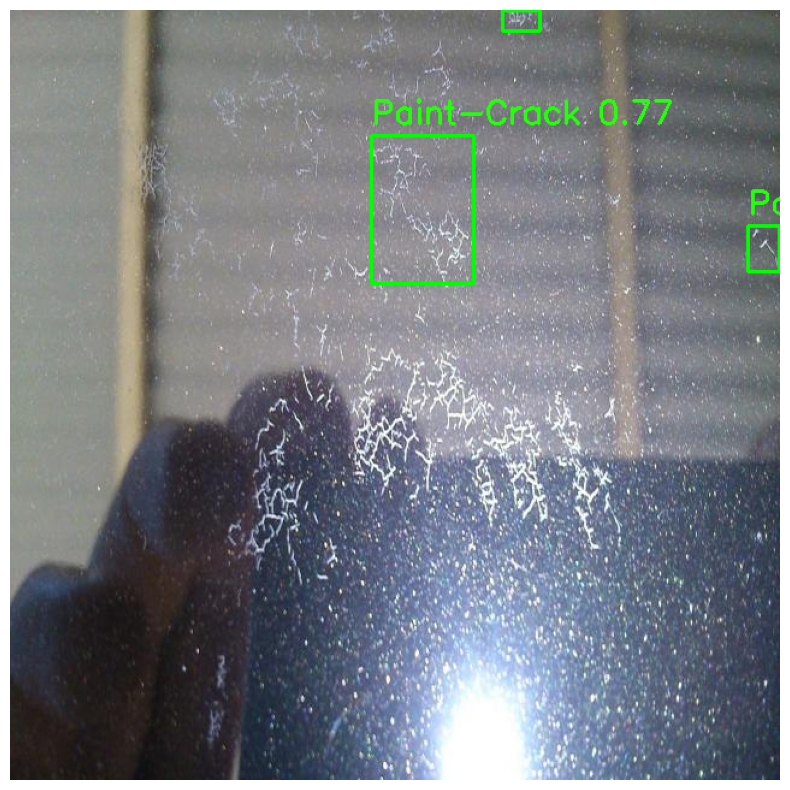


0: 640x640 1 Crack, 9.8ms
Speed: 1.6ms preprocess, 9.8ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


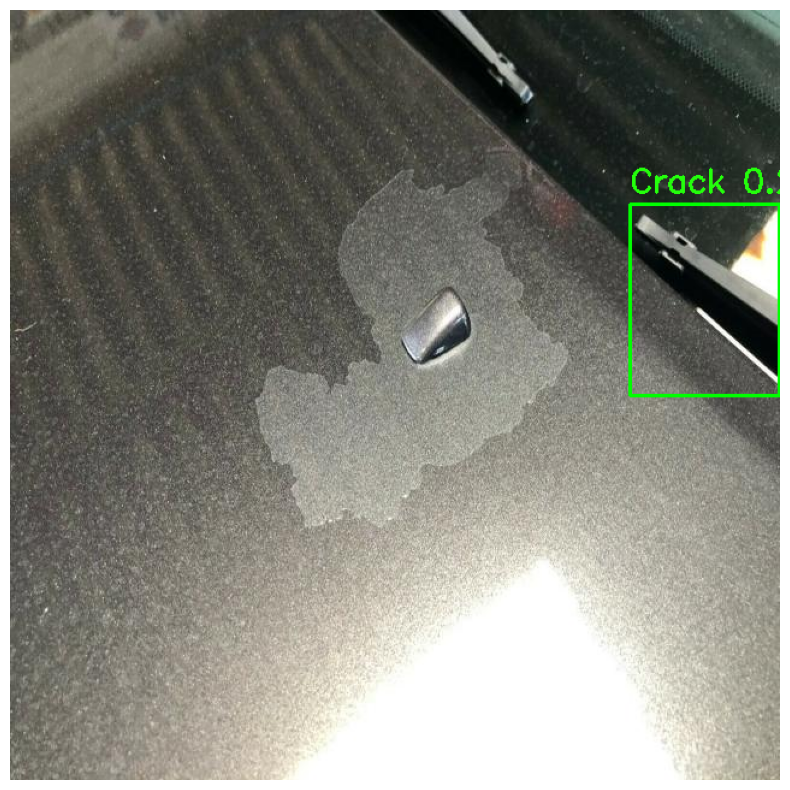


0: 640x640 1 Rust, 10.4ms
Speed: 2.0ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


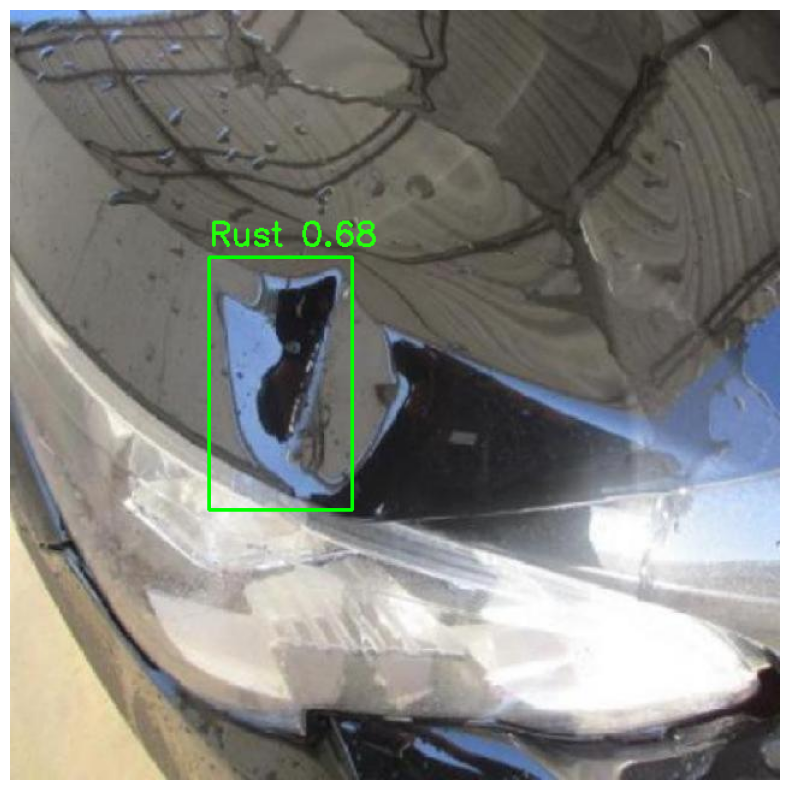


0: 640x640 1 Dent, 10.2ms
Speed: 2.1ms preprocess, 10.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


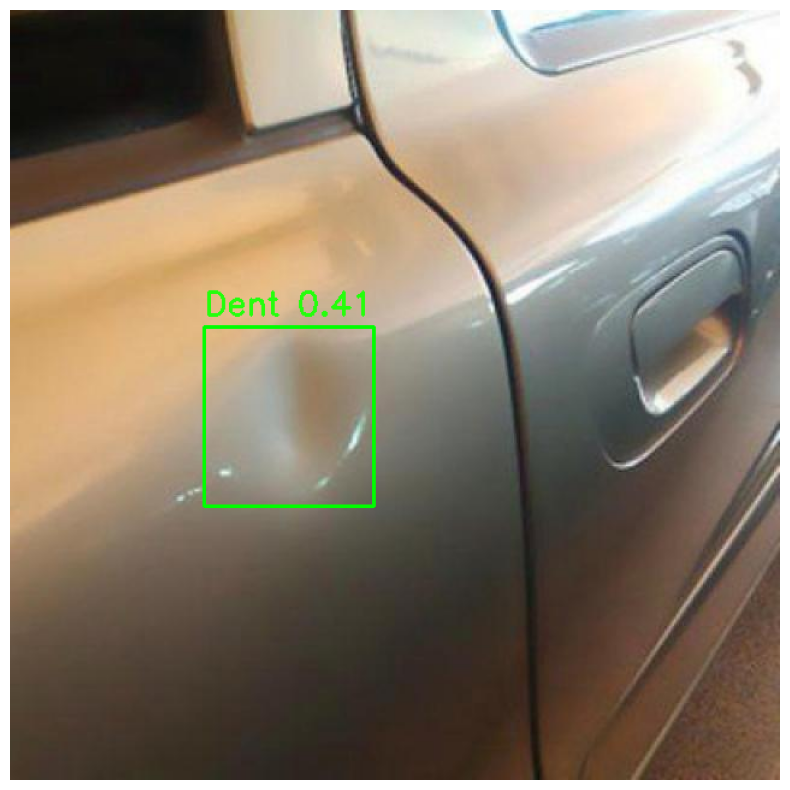


0: 640x640 1 Dent, 1 PDR-Dent, 10.4ms
Speed: 1.7ms preprocess, 10.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


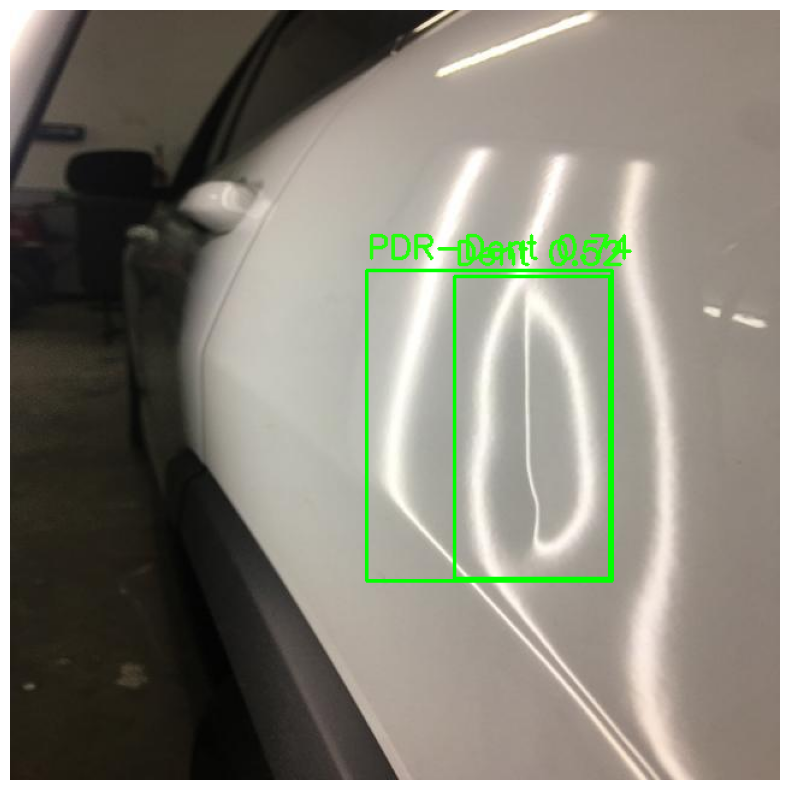


0: 640x640 1 Rust, 9.8ms
Speed: 1.8ms preprocess, 9.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


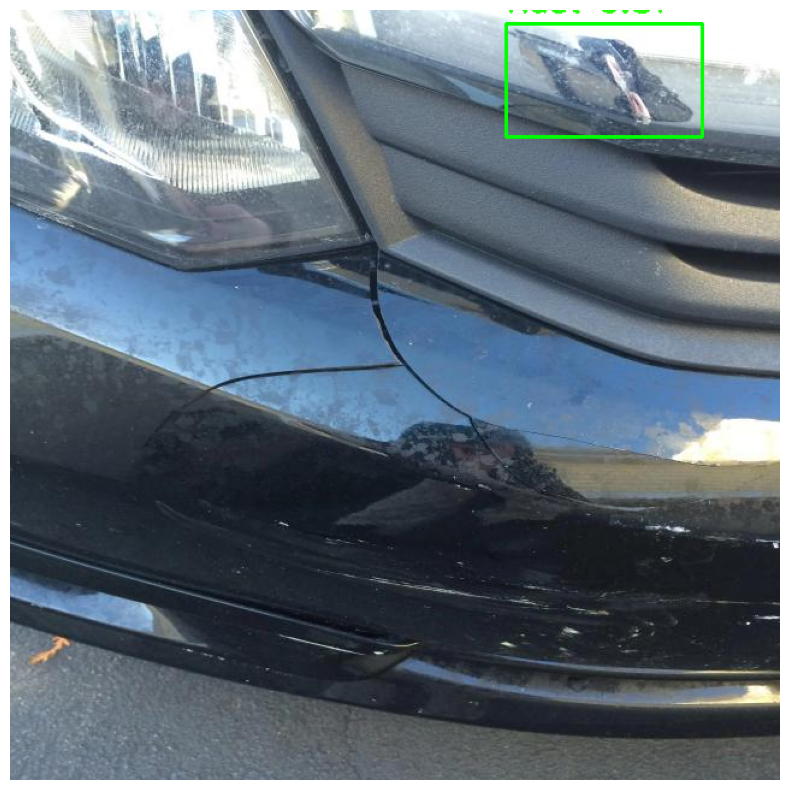

In [ ]:
# Load the model
model = YOLO('/content/runs/detect/train/weights/best.pt')

# Update the path to the test image directory
directory = data['test']

# Set the confidence threshold for predictions
confidence_threshold = 0.25

# Get a list of all the image files in the directory
image_files = [f for f in os.listdir(directory) if f.endswith('.jpg') or f.endswith('.png')]

# For each image file
for image_file in image_files:
    # Load the image
    img = cv2.imread(os.path.join(directory, image_file))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB

    # Predict the objects in the image
    results = model.predict(img)

    # Check if there are any results and process the first Results object
    if len(results) > 0:
        result = results[0]

        # Access the boxes attribute, ensure it is transferred to CPU and converted to numpy
        if hasattr(result, 'boxes') and result.boxes:
            detections = result.boxes.data.cpu().numpy()  # Transfer to CPU and convert to numpy

            # Iterate over each detection
            for detection in detections:
                conf = detection[4]  # Get the confidence score
                if conf > confidence_threshold:
                    x1, y1, x2, y2 = map(int, detection[:4])
                    label = result.names[int(detection[5])]

                    # Draw the bounding box and label on the image
                    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(img, f"{label} {conf:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36, 255, 12), 2)

    # Show the image using matplotlib
    plt.figure(figsize=(12, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.show()


In [ ]:
# Zip the output directory
!zip -r /content/runs.zip ./runs